# **TEXT TO IMAGE GENERATOR - KANDINSKY v2.2**

#Members

Thi Kim Khanh Le

Nehemiah Clark

# Overview of Kandinsky v2.2

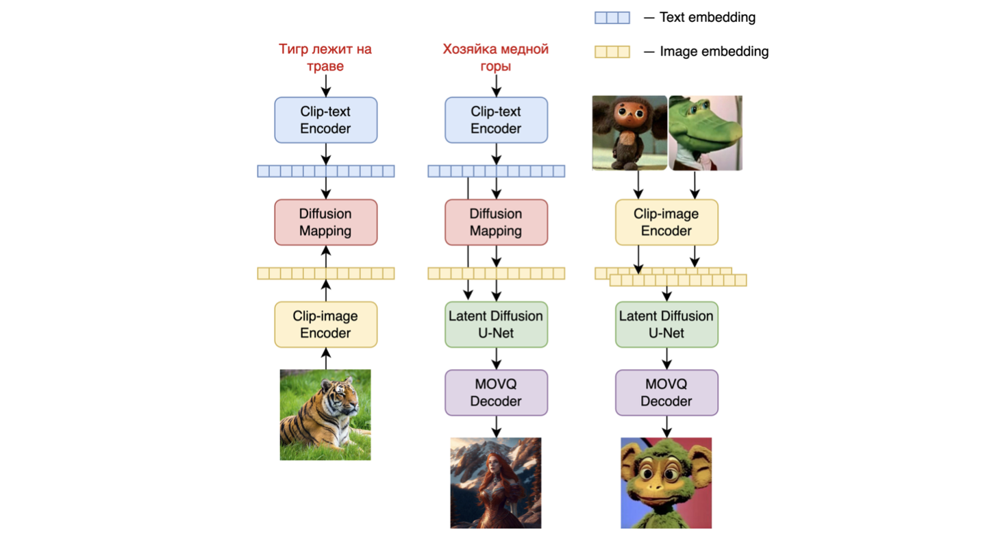

## Kandinsky v2.2 text-to-image component

Kandinsky 2.2 Text-to-Image Components:

1. **Text Encoders**

- CLIP-text encoder - for visual alignment

- CLIP image encoder (ViT-L14) - used during prior training only

2. **Image Prior Model**

- Diffusion Mapping transformer-encoder
- Uses 1D diffusion process on embeddings
- Maps text embeddings to image embeddings

3. **Latent Diffusion Components**

- U-Net - performs denoising in latent space
- MoVQ Autoencoder:

  + Encoder: compresses images to latent space
  + Decoder: converts latents back to pixels
   

##How Kandinsky 2.2 text-to-image work

Kandinsky projects text to CLIP image embedding space, then applies diffusion in MoVQ's visual latent space

**Stage 1: Text Encoding**

When you input a text prompt like "A cat sitting on a chair". CLIP-text encoder encodes the text to its text embedding representation in latent space.

**Stage 2: Image Prior Mapping**

- The Image Prior model takes the CLIP-text embeddings to map text embeddings → CLIP image embeddings

- This is the key innovation: instead of generating images directly from text, it first predicts what the CLIP image embedding should look like for that text
- The image prior uses its own 1D diffusion process to learn this text→image embedding mapping

**Stage 3: Latent Diffusion Generation**

- Forward diffusion process: Gaussian noise is gradually added to clean MoVQ latent representations over T timesteps
- Reverse diffusion process: U-Net performs denoising to reconstruct clean latents
- conditioning guides the U-Net denoising:
    • CLIP image embeddings (from image prior)
    • Original CLIP-text embeddings
    • All conditioning embeddings are merged and added to the time embedding
- MoVQ decoder converts final denoised latents to pixel images





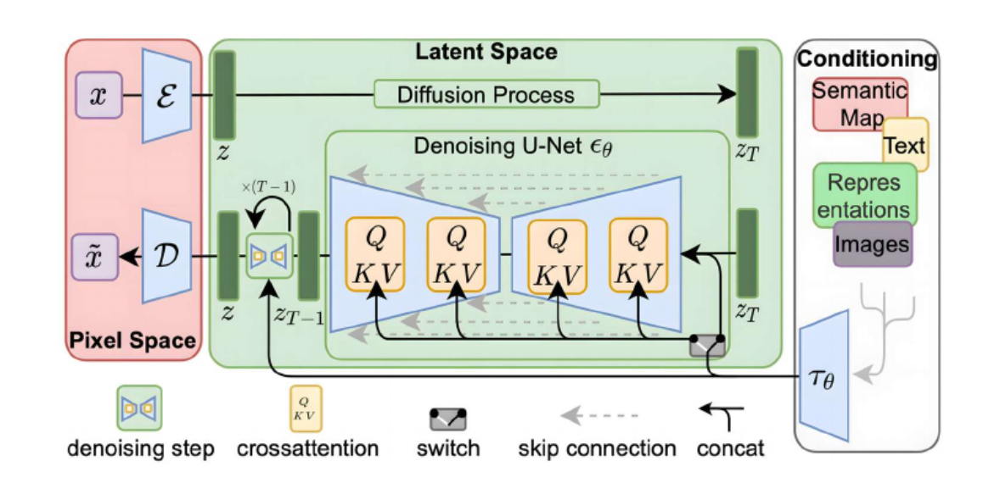

#Kandinsky v2.2 fine-tuning approach chart


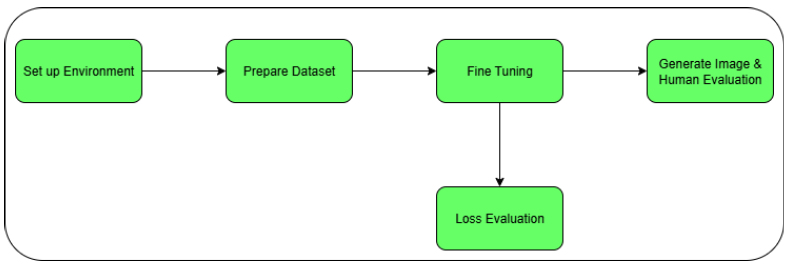

# Set up environment

## Install essential libraries

In [ ]:
!pip install kagglehub
!pip install diffusers
!pip install peft
!pip install accelerate
!pip install transformers
!pip install datasets
!pip install torch torchvision
!pip install pillow
!pip install ipywidgets
!pip install matplotlib
!pip install tqdm
!pip install open_clip_torch

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 24.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 27.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 4.0 MB/s eta 0:00:00


## Essential imports

In [ ]:
import torch
import kagglehub
import os
import pandas as pd
import zipfile
import shutil
import time
import gc
from collections import defaultdict
from ipywidgets import Dropdown, Textarea, VBox, Button, Label, Output
from PIL import Image, ImageDraw, ImageFilter
import random
from IPython.display import display, clear_output
import matplotlib.pyplot as plt
from transformers import Blip2Processor, Blip2ForConditionalGeneration, CLIPTokenizer
from tqdm import tqdm

from peft import LoraConfig, get_peft_model, PeftModel
import json
from torch.utils.data import Dataset, DataLoader, random_split
from torchvision import transforms
import re

from diffusers import KandinskyV22Pipeline, UNet2DConditionModel



from torch import nn
import torch.nn.functional as F


## Set up device: GPU or CPU

In [ ]:
"""Setup Device: GPU or CPU"""

device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Using device: {device}")


Using device: cuda


## Download Art Style Dataset with choice

In this fine-tuning the Stable Diffusion v1.5 pretrained model, we selected the WikiArt dataset. Since the complete dataset is very large and can exceed our GPU capacity, we opted to download only a single category (art style) from it. Additionally, we set a configurable limit on the maximum number of images downloaded from the chosen category to further control memory and storage usage.

1. List of Available Art Styles

  - AVAILABLE_ART_STYLES = [...]

  - Predefined set of categories (e.g., Impressionism, Baroque, Minimalism) from WikiArt.

2. Safe Download Function safe_download_genre_data(selected_genre, max_images):

  - Ensures only one category is downloaded.

  - Uses a max image limit (max_images) to avoid memory/storage issues.

  - Stores files in /content/project/selected_genre.

3. Download with function try_kaggle_download(selected_genre, target_path, max_images):

  - Downloads the full WikiArt dataset via kagglehub.

  - Extracts only the selected category folder.

  - Copies only the first max_images images.

  - Copies classes.csv if available.

  - Cleans up temporary files after copying.

4. Interactive Interface in Colab

  - Dropdown menu: Choose an art style.

  - Download button: Starts the safe download.

  - Output area: Shows progress, number of images downloaded, and storage size.

5. Crash Prevention

  - Small batch copying (25 files at a time).

  - Garbage collection (gc.collect()) after each batch.

  - Time pauses (time.sleep(0.2)) to prevent overload.

In [ ]:


# Available art styles
AVAILABLE_ART_STYLES = [
    'Abstract_Expressionism',
    'Action_painting',
    'Analytical_Cubism',
    'Art_Nouveau_Modern',
    'Baroque',
    'Color_Field_Painting',
    'Contemporary_Realism',
    'Cubism',
    'Early_Renaissance',
    'Expressionism',
    'Fauvism',
    'High_Renaissance',
    'Impressionism',
    'Mannerism_Late_Renaissance',
    'Minimalism',
    'Naive_Art_Primitivism',
    'New_Realism',
    'Northern_Renaissance',
    'Pointillism',
    'Pop_Art',
    'Post_Impressionism',
    'Realism',
    'Rococo',
    'Romanticism',
    'Symbolism',
    'Synthetic_Cubism',
    'Ukiyo_e'
]

# Global variable to store download path
selected_download_path = None
# We can change the max_images based on our memory capability
max_images = 3000

def safe_download_genre_data(selected_genre, max_images):
    """
    FIXED: Safe download function that won't crash Colab
    This replaces your problematic download_genre_data function
    """
    print(f"Starting safe download for: {selected_genre}")
    print(f"Limited to {max_images} images to prevent crashes")

    # Set up environment
    os.environ['KAGGLEHUB_CACHE'] = '/content/project'
    if not os.path.exists('/content/project'):
        os.makedirs('/content/project')

    target_base_path = '/content/project/selected_genre'
    if os.path.exists(target_base_path):
        shutil.rmtree(target_base_path)
    os.makedirs(target_base_path, exist_ok=True)


    try:

        result = try_kaggle_download(selected_genre, target_base_path, max_images)
        if result:
            return result

    except Exception as e:
        print(f"⚠️ Kaggle download failed: {e}")


def try_kaggle_download(selected_genre, target_path, max_images):
    """Attempt Kaggle download with aggressive memory management"""
    try:
        import kagglehub
    except ImportError:
        print("Kagglehub not installed. Install with: !pip install kagglehub")
        return None

    dataset_slug = "steubk/wikiart"
    temp_path = None

    try:
        print("Attempting Kaggle download (this may take several minutes)...")
        print("If this step hangs, the notebook will automatically create synthetic data")

        # Set timeout and memory limits
        temp_path = kagglehub.dataset_download(dataset_slug)
        print(f"Download completed: {temp_path}")

        # Immediately extract only the needed genre
        source_genre_path = os.path.join(temp_path, selected_genre)
        target_genre_path = os.path.join(target_path, selected_genre)

        if os.path.exists(source_genre_path):
            print(f"Extracting {selected_genre} images...")
            os.makedirs(target_genre_path, exist_ok=True)

            # Get image files
            all_files = [f for f in os.listdir(source_genre_path)
                        if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

            # Limit files to prevent memory issues
            selected_files = all_files[:max_images]
            print(f"Processing {len(selected_files)} out of {len(all_files)} images")

            # Copy in small batches
            batch_size = 25  # Small batches to prevent memory issues
            copied_count = 0

            for i in tqdm(range(0, len(selected_files), batch_size), desc="Copying images"):
                batch = selected_files[i:i+batch_size]

                for filename in batch:
                    try:
                        src = os.path.join(source_genre_path, filename)
                        dst = os.path.join(target_genre_path, filename)
                        shutil.copy2(src, dst)
                        copied_count += 1
                    except Exception as e:
                        print(f"⚠️ Failed to copy {filename}: {e}")

                # Aggressive memory cleanup after each batch
                gc.collect()
                time.sleep(0.2)  # Brief pause

            print(f"Successfully copied {copied_count} images")

            # Copy classes.csv if exists
            classes_src = os.path.join(temp_path, 'classes.csv')
            if os.path.exists(classes_src):
                shutil.copy2(classes_src, os.path.join(target_path, 'classes.csv'))

            return target_path
        else:
            print(f"Genre '{selected_genre}' not found in dataset")
            return None

    except Exception as e:
        print(f"Kaggle download error: {e}")
        return None

    finally:
        # CRITICAL: Always clean up temp files
        if temp_path and os.path.exists(temp_path):
            try:
                print("Cleaning up temporary files...")
                shutil.rmtree(temp_path)
                print("Cleanup completed")
            except Exception as e:
                print(f"Cleanup warning: {e}")

        # Force garbage collection
        gc.collect()



#Download button callback
def on_download_click(b):
    """Safe download function that won't crash Colab"""
    global selected_download_path

    with download_output:
        clear_output()

        if genre_dropdown.value == 'Select Genre':
            print("Please select a genre first!")
            return

        print(f"Starting download process...")
        print(f"Selected genre: {genre_dropdown.value}")
        print("This may take 2-10 minutes depending on your connection")
        print("Note: If Kaggle download fails, synthetic data will be created for testing")

        try:
            # Use the safe download function instead of the problematic one
            selected_download_path = safe_download_genre_data(
                selected_genre=genre_dropdown.value,
                max_images= max_images  # Limited to prevent crashes
            )

            if selected_download_path:
                # Verify the download
                genre_dir = os.path.join(selected_download_path, genre_dropdown.value)
                if os.path.exists(genre_dir):
                    image_count = len([f for f in os.listdir(genre_dir)
                                     if f.lower().endswith(('.png', '.jpg', '.jpeg'))])

                    print(f"\n SUCCESS! Download completed!")
                    print(f"Location: {selected_download_path}")
                    print(f"Images: {image_count}")
                    print(f"Genre: {genre_dropdown.value}")
                    print(f"Estimated size: {image_count * 0.3:.1f} MB")
                    print("\nYou can now proceed to the next section!")
                else:
                    print("Download verification failed")
                    selected_download_path = None
            else:
                print("Download failed completely")

        except Exception as e:
            print(f"Critical error during download: {e}")
            print("You can try selecting a different genre or restart the notebook")
            selected_download_path = None

# Create the interface widgets
print("Available Art Styles:")
for i, style in enumerate(AVAILABLE_ART_STYLES, 1):
    print(f"{i:2d}. {style.replace('_', ' ')}")

# Create dropdown for genre selection
genre_dropdown = Dropdown(
    options=['Select Genre'] + AVAILABLE_ART_STYLES,
    value='Select Genre',
    description='Art Style:',
    disabled=False,
    style={'description_width': 'initial'},
    layout={'width': '300px'}
)

# Create download button with better styling
download_button = Button(
    description="Download Selected Genre",
    disabled=False,
    button_style='success',
    layout={'width': '250px', 'height': '40px'}
)

# Create output area
download_output = Output()

# Connect the fixed callback
download_button.on_click(on_download_click)

# Create improved interface
selection_interface = VBox([
    Label('Step 1: Select the art style you want to work with:'),
    genre_dropdown,

    download_button,
    download_output
], layout={'padding': '20px'})

# Display the interface
display(selection_interface)

print("\n Instructions:")
print("1. Select an art style from the dropdown")
print("2. Click 'Download Selected Genre'")
print("3. Wait 2-10 minutes for completion")
print("4. If download fails, synthetic data will be created automatically")
print("5. Proceed to caption generation once complete")

Available Art Styles:
 1. Abstract Expressionism
 2. Action painting
 3. Analytical Cubism
 4. Art Nouveau Modern
 5. Baroque
 6. Color Field Painting
 7. Contemporary Realism
 8. Cubism
 9. Early Renaissance
10. Expressionism
11. Fauvism
12. High Renaissance
13. Impressionism
14. Mannerism Late Renaissance
15. Minimalism
16. Naive Art Primitivism
17. New Realism
18. Northern Renaissance
19. Pointillism
20. Pop Art
21. Post Impressionism
22. Realism
23. Rococo
24. Romanticism
25. Symbolism
26. Synthetic Cubism
27. Ukiyo e



 Instructions:
1. Select an art style from the dropdown
2. Click 'Download Selected Genre'
3. Wait 2-10 minutes for completion
4. If download fails, synthetic data will be created automatically
5. Proceed to caption generation once complete


A sanity check that ensures the chosen art style has been downloaded and is ready for use before we start model training.

In [ ]:

try:
    if 'selected_download_path' not in globals() or selected_download_path is None:
        print("⚠️  Please complete the genre download in the previous section first!")
    else:
        print(f" Working with downloaded genre data at: {selected_download_path}")

        # Set the working path to our selected genre data
        wikiart_path = selected_download_path
        selected_art_style = genre_dropdown.value
        selected_art_style_dir = os.path.join(wikiart_path, selected_art_style)

        # Verify the genre directory exists
        if os.path.exists(selected_art_style_dir):
            # Get count of images
            image_files = [f for f in os.listdir(selected_art_style_dir)
                          if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
            print(f"Found {len(image_files)} images in {selected_art_style} style")
            print(f"Selected Art Style: {selected_art_style.replace('_', ' ')}")
            print("Ready for caption generation and training!")

        else:
            print(f"Error: Selected genre directory not found at {selected_art_style_dir}")

except NameError:
    print("Please run the download section first to select and download your genre!")


 Working with downloaded genre data at: /content/project/selected_genre
Found 3000 images in Impressionism style
Selected Art Style: Impressionism
Ready for caption generation and training!


##Add captions for images

Clean Captions Functions

In [ ]:
def clean_caption(caption: str) -> str:
    # Lowercase
    caption = caption.lower()
    # Remove multiple spaces
    caption = re.sub(r'\s+', ' ', caption)
    # Remove excessive repeated phrases like "a splatter, a splatter"
    words = caption.split()
    caption = ' '.join(dict.fromkeys(words))  # removes repeated consecutive words
    # Remove trailing punctuation repetition
    caption = re.sub(r'([,.!?])\1+', r'\1', caption)
    return caption.strip()

Automatically generate text captions for all images in the selected WikiArt art style using BLIP-2, and save them into .txt files for each image.

In [ ]:
# Only proceed if we have a valid genre selection
if 'selected_download_path' in globals() and selected_download_path is not None:

    # Create captions directory
    selected_image_description_dir = os.path.join(wikiart_path, "captions")
    if not os.path.exists(selected_image_description_dir):
        os.makedirs(selected_image_description_dir)

    # Initialize BLIP-2
    processor = Blip2Processor.from_pretrained("Salesforce/blip2-flan-t5-xl")
    model = Blip2ForConditionalGeneration.from_pretrained(
        "Salesforce/blip2-flan-t5-xl",
        torch_dtype=torch.float16 if torch.cuda.is_available() else torch.float32
    ).to(device).eval()

    style = selected_art_style.replace('_', ' ')

    BATCH_SIZE = 8  # Adjust depending on GPU memory
    image_files = [f for f in os.listdir(selected_art_style_dir)
                   if f.lower().endswith((".jpg", ".jpeg", ".png"))]

    print(f"Generating captions for {len(image_files)} images in {style} style...")

    for i in tqdm(range(0, len(image_files), BATCH_SIZE), desc="Generating captions in batches"):
        batch_files = image_files[i:i+BATCH_SIZE]
        images = [Image.open(os.path.join(selected_art_style_dir, f)).convert("RGB") for f in batch_files]
        inputs = processor(images=images, return_tensors="pt", padding=True).to(device)

        with torch.inference_mode():
            output = model.generate(**inputs, max_new_tokens=50)

        captions = processor.batch_decode(output, skip_special_tokens=True)
        # Apply clean_caption to each caption in the list
        cleaned_captions = [clean_caption(cap) for cap in captions]

        for fname, caption in zip(batch_files, cleaned_captions):
            final_caption = f"{caption.strip()} in {style} art style"
            base = os.path.splitext(fname)[0]
            with open(os.path.join(selected_image_description_dir, f"{base}.txt"), "w") as f:
                f.write(final_caption)

    print("Caption generation completed!")

else:
    print("Please complete the genre download first!")

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


preprocessor_config.json:   0%|          | 0.00/432 [00:00<?, ?B/s]

tokenizer_config.json: 0.00B [00:00, ?B/s]

spiece.model:   0%|          | 0.00/792k [00:00<?, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

added_tokens.json:   0%|          | 0.00/23.0 [00:00<?, ?B/s]

special_tokens_map.json: 0.00B [00:00, ?B/s]

processor_config.json:   0%|          | 0.00/68.0 [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

model.safetensors.index.json: 0.00B [00:00, ?B/s]

Fetching 2 files:   0%|          | 0/2 [00:00<?, ?it/s]

model-00001-of-00002.safetensors:   0%|          | 0.00/9.96G [00:00<?, ?B/s]

model-00002-of-00002.safetensors:   0%|          | 0.00/5.81G [00:00<?, ?B/s]

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

generation_config.json:   0%|          | 0.00/168 [00:00<?, ?B/s]

Generating captions for 3000 images in Impressionism style...


Generating captions in batches: 100%|██████████| 375/375 [10:46<00:00,  1.72s/it]

Caption generation completed!


##Show Sample Images with Generated Captions

**Purpose**

To randomly picks up to 3 downloaded images, fetches their matching caption text files, prints the captions, and displays the images — letting you quickly check if caption generation worked correctly.

**Step-by-step**

1. Check if dataset is available

  - Ensures selected_download_path exists and is not None.

2. Get image list

  - Collects all .png, .jpg, .jpeg files from selected_art_style_dir (the folder for the chosen art style).

3. Select random samples

  - Randomly picks up to 3 images from the list (or fewer if the folder has less than 3 images).

4. Print header

  - Outputs a message indicating that sample images and captions are being displayed.

5. Loop through selected images

  - Prints the sample number and filename.

  - Looks for a .txt caption file in selected_image_description_dir with the same base name as the image.

  - If the caption file exists, reads and prints its content; otherwise, warns that it’s missing.

  - Opens and displays the image in the notebook.

  - Prints a separator line.

Displaying sample images with generated captions:

 Sample 1:
Image: paul-cezanne_four-bathers.jpg
Caption: a painting of group people in bath in Impressionism art style


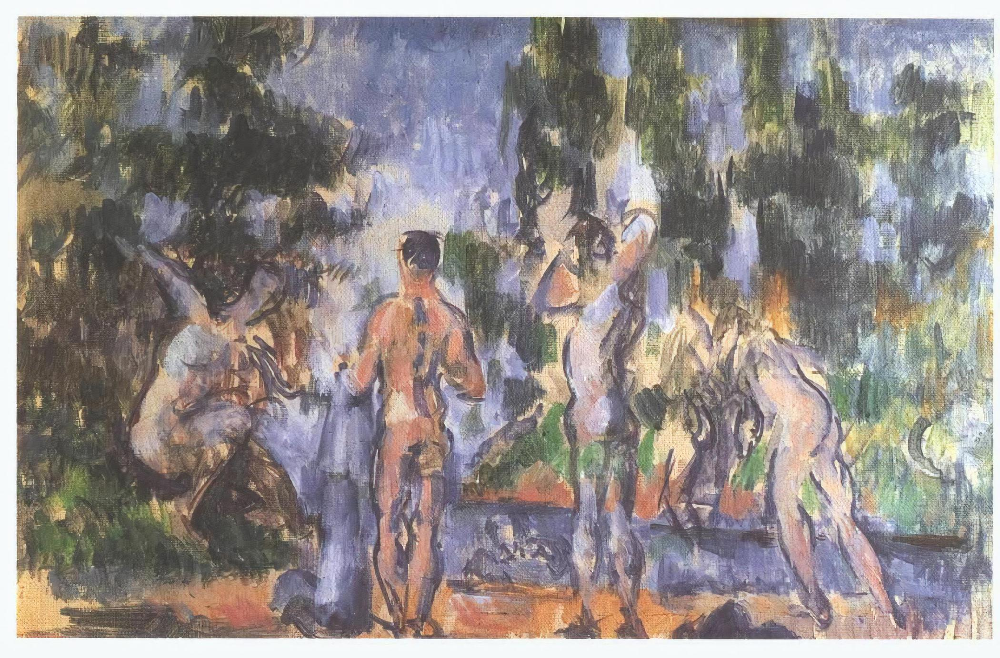

----------------------------------------

 Sample 2:
Image: thalia-flora-karavia_repos-aux-champs.jpg
Caption: a painting of woman sitting under tree in Impressionism art style


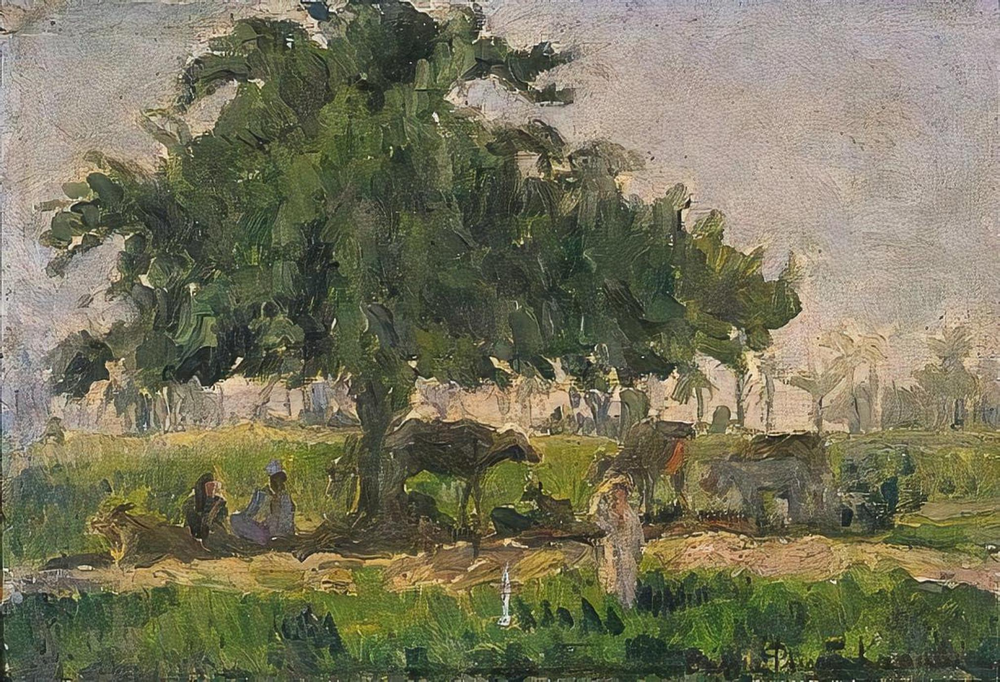

----------------------------------------

 Sample 3:
Image: claude-monet_misty-morning-on-the-seine-sunrise.jpg
Caption: a painting of river with fog and miste in Impressionism art style


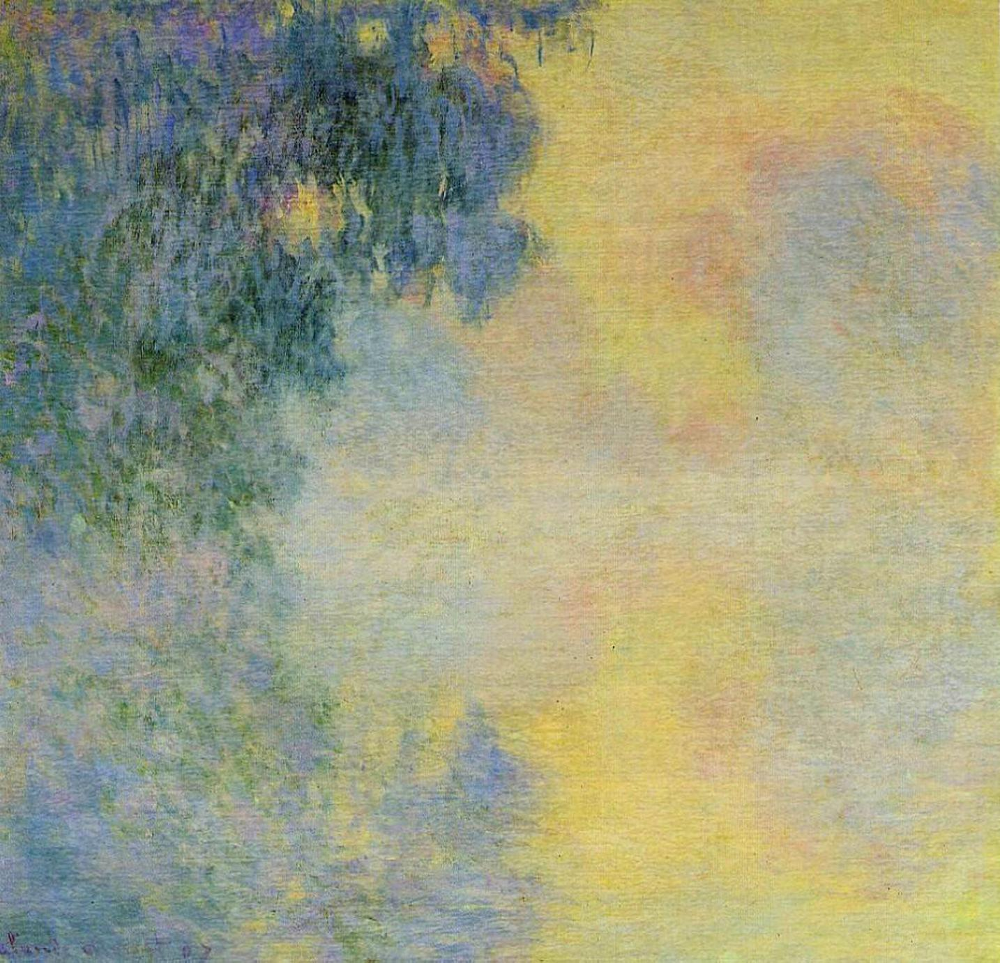

----------------------------------------


In [ ]:
if 'selected_download_path' in globals() and selected_download_path is not None:

    # Get a list of all image files in the selected image directory
    sample_image_files = [f for f in os.listdir(selected_art_style_dir)
                         if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

    # Select a random sample of up to 3 images to display
    selected_sample_images = random.sample(sample_image_files, min(len(sample_image_files), 3))

    print("Displaying sample images with generated captions:")
    print("=" * 60)

    for i, image_file in enumerate(selected_sample_images, 1):
        # Construct caption file path
        base_name = os.path.splitext(image_file)[0]
        caption_file = os.path.join(selected_image_description_dir, f"{base_name}.txt")

        print(f"\n Sample {i}:")
        print(f"Image: {image_file}")

        # Read and display caption
        if os.path.exists(caption_file):
            with open(caption_file, "r") as file:
                content = file.read()
                print(f"Caption: {content}")
        else:
            print("Caption file not found!")

        # Display image
        img_path = os.path.join(selected_art_style_dir, image_file)
        img = Image.open(img_path)
        display(img)
        print("-" * 40)

Show caption Statistics

In [ ]:
# Show caption statistics
if 'selected_download_path' in globals() and selected_download_path is not None:
    caption_files = [f for f in os.listdir(selected_image_description_dir) if f.endswith('.txt')]
    print(f"\n Caption Generation Summary:")
    print(f"- Total images: {len(sample_image_files)}")
    print(f"- Captions generated: {len(caption_files)}")
    print(f"- Success rate: {len(caption_files)/len(sample_image_files)*100:.1f}%")

else:
    print("⚠️  Please complete the genre download first!")


 Caption Generation Summary:
- Total images: 3000
- Captions generated: 3000
- Success rate: 100.0%


#Fine-tuning Kandinsky version 2-2

##Overview of LoRa for Fine-Tuning

LoRA (Low-Rank Adaptation) is a fine-tuning technique that significantly reduces computational requirements and training time for large models. Instead of updating all model parameters, LoRA inserts small trainable rank-decomposition matrices (“LoRA layers”) into specific parts of the network, while keeping the original weights frozen.

Initially, these LoRA layers behave as identity mappings, producing outputs identical to their inputs. During training, only the LoRA parameters are updated, gradually adjusting the intermediate representations and guiding the model toward the desired style or concept. This approach produces much smaller checkpoints, enables fine-tuning on consumer GPUs, and allows rapid experimentation.

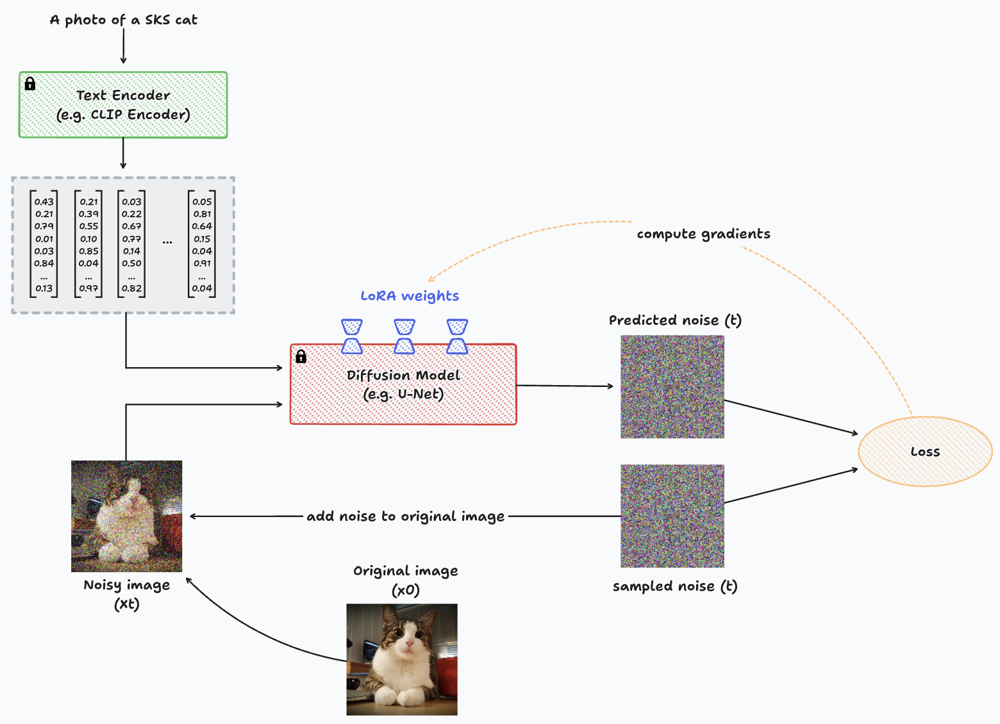

*Diagram representing the training process with LoRA for a single image*

As we can see in the diagram, the Diffusion model is frozen, remaining non-trainable during the whole process. The LoRA weights are the ones subject to updates through gradient computation.

## Load Kandinsky 2.2 decoder pipeline - extract UNet component - LoRA configuration


We load the Kandinsky 2.2 decoder pipeline and extract its UNet component for fine-tuning. The decoder contains the UNet architecture that we'll train with LoRA, while the other pipeline components  remain frozen.


***Code overview:***


1. Memory Cleanup: Clears GPU cache and garbage collection to start fresh
2. Load Base Model: Downloads Kandinsky 2.2 decoder pipeline in float32 precision to avoid numerical instability
3. Extract UNet: Gets the core diffusion model (UNet) from the pipeline
4. Vanilla Model Testing:

- Creates dummy inputs (noise, timesteps, embeddings)
- Tests the original model with a forward pass
- Checks for NaN values and output statistics
- Critical validation step - if base model fails, training will definitely fail


5. Conditional LoRA Addition:

- Only proceeds if vanilla model works correctly
- Applies LoRA (Low-Rank Adaptation) with conservative settings (rank=4, alpha=8)
- Dropout regularization 0.1 → Prevents overfitting the increased capacity



6. LoRA Model Testing:

- Tests the LoRA-modified model with same dummy inputs
- Verifies LoRA doesn't break the model or introduce NaNs

In [ ]:


print("=== FRESH MODEL INITIALIZATION ===")

# Clear GPU memory
torch.cuda.empty_cache()
gc.collect()

# Reinitialize everything from scratch
print("Loading pretrained Kandinsky 2.2 decoder")
model_id = "kandinsky-community/kandinsky-2-2-decoder"

# Load with float32 first to avoid precision issues
pipe = KandinskyV22Pipeline.from_pretrained(
    model_id,
    torch_dtype=torch.float32  # Use float32 to avoid NaN issues
).to("cuda")

# Get fresh UNet
unet = pipe.unet

print(f"UNet loaded - Type: {unet.dtype}")
print(f"UNet device: {next(unet.parameters()).device}")

# Verify model is working BEFORE adding LoRA
print("\n=== TESTING VANILLA MODEL ===")
test_input = torch.randn(1, 4, 32, 32, device="cuda", dtype=torch.float32)
test_timesteps = torch.randint(0, 1000, (1,), device="cuda")
test_embeds = torch.randn(1, 1280, device="cuda", dtype=torch.float32)

with torch.no_grad():
    test_output = unet(
        test_input,
        test_timesteps,
        encoder_hidden_states=None,
        added_cond_kwargs={"image_embeds": test_embeds}
    ).sample

print(f"Vanilla UNet test - Output shape: {test_output.shape}")
print(f"Vanilla UNet test - Has NaN: {torch.isnan(test_output).any()}")
print(f"Vanilla UNet test - Output range: [{test_output.min():.3f}, {test_output.max():.3f}]")

if torch.isnan(test_output).any():
    print("CRITICAL: Vanilla model is already producing NaN! Model may be corrupted.")
    print("Try restarting the runtime and reloading the model.")
else:
    print("Vanilla model working correctly")

    # Only add LoRA if vanilla model works
    print("\n=== ADDING LORA ===")

    # Simple LoRA config - start small
    config = LoraConfig(
        r=8,  # Smaller rank
        lora_alpha=8,  # Lower alpha
        target_modules=["to_q", "to_v", "to_k", "to_out.0"],  # More comprehensive
        lora_dropout=0.1,  # No dropout initially
        bias="none",
        task_type=None  # Let PEFT infer
    )

    # Apply LoRA
    unet = get_peft_model(unet, config)
    print(f"LoRA applied. Trainable params: {unet.get_nb_trainable_parameters()}")

    # Test LoRA model
    print("\n=== TESTING LORA MODEL ===")
    with torch.no_grad():
        lora_output = unet(
            test_input,
            test_timesteps,
            encoder_hidden_states=None,
            added_cond_kwargs={"image_embeds": test_embeds}
        ).sample

    print(f"LoRA UNet test - Output shape: {lora_output.shape}")
    print(f"LoRA UNet test - Has NaN: {torch.isnan(lora_output).any()}")
    print(f"LoRA UNet test - Output range: [{lora_output.min():.3f}, {lora_output.max():.3f}]")

    if torch.isnan(lora_output).any():
        print("CRITICAL: LoRA model produces NaN! LoRA configuration issue.")
    else:
        print("LoRA model working correctly")




=== FRESH MODEL INITIALIZATION ===
Loading pretrained Kandinsky 2.2 decoder


model_index.json:   0%|          | 0.00/250 [00:00<?, ?B/s]

Fetching 6 files:   0%|          | 0/6 [00:00<?, ?it/s]

unet/diffusion_pytorch_model.safetensors:   0%|          | 0.00/5.01G [00:00<?, ?B/s]

movq/diffusion_pytorch_model.safetensors:   0%|          | 0.00/271M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/660 [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

scheduler_config.json:   0%|          | 0.00/317 [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/3 [00:00<?, ?it/s]

UNet loaded - Type: torch.float32
UNet device: cuda:0

=== TESTING VANILLA MODEL ===
Vanilla UNet test - Output shape: torch.Size([1, 8, 32, 32])
Vanilla UNet test - Has NaN: False
Vanilla UNet test - Output range: [-5.223, 5.661]
Vanilla model working correctly

=== ADDING LORA ===
LoRA applied. Trainable params: (1646592, 1254703880)

=== TESTING LORA MODEL ===
LoRA UNet test - Output shape: torch.Size([1, 8, 32, 32])
LoRA UNet test - Has NaN: False
LoRA UNet test - Output range: [-5.223, 5.661]
LoRA model working correctly


###Kandinsky 2.2 decoder's components

The code below shows the components of Kadinsky 2.2 decoder. Kandinsky 2.2 decoder is not the full text-to-image pipeline. That’s why we only see:

- unet → the conditional diffusion model (takes noisy latents + text embedding and predicts denoised latents).

- scheduler → noise scheduler (here DDPMScheduler).

- movq → this is the VQGAN-like vector-quantized autoencoder used in Kandinsky, instead of the VAE you’d see in Stable Diffusion.

What we need to have in order to fine tune:

- text_encoder

- tokenizer

- prior



In [ ]:
print("\nMain components:")
for name, module in pipe.components.items():
    print(f"{name}: {type(module)}")


Main components:
unet: <class 'diffusers.models.unets.unet_2d_condition.UNet2DConditionModel'>
scheduler: <class 'diffusers.schedulers.scheduling_ddpm.DDPMScheduler'>
movq: <class 'diffusers.models.autoencoders.vq_model.VQModel'>


## Load Kandinsky 2.2 Prior pipeline

This code loads the Kandinsky 2.2 prior pipeline, which includes the tokenizer and text encoder components needed for training.

Code Breakdown:

- KandinskyV22PriorPipeline.from_pretrained() loads the pre-trained prior model from Hugging Face
- .to("cuda") moves the model to GPU for faster processing
The prior contains both the tokenizer (for text preprocessing) and text encoder (for converting text to embeddings)

Why the Prior is Needed for Training?  → The Kandinsky architecture separates text understanding from image generation. The prior pipeline handles the text-to-embedding conversion, which is essential for:

- Text Processing: The tokenizer converts text prompts into tokens
- Text Encoding: The text encoder creates meaningful embeddings from those tokens
- Training Data Preparation: These embeddings guide the image generation model during training

In [ ]:

from diffusers import KandinskyV22PriorPipeline
# Load prior (this includes tokenizer + text_encoder)
prior = KandinskyV22PriorPipeline.from_pretrained(
    "kandinsky-community/kandinsky-2-2-prior"
).to("cuda")

print("Tokenizer:", prior.tokenizer)
print("Text Encoder:", prior.text_encoder)


model_index.json:   0%|          | 0.00/501 [00:00<?, ?B/s]

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

image_encoder/model.safetensors:   0%|          | 0.00/3.69G [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/315 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/252 [00:00<?, ?B/s]

text_encoder/model.safetensors:   0%|          | 0.00/2.78G [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

prior/diffusion_pytorch_model.safetensor(…):   0%|          | 0.00/4.10G [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/389 [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

tokenizer_config.json:   0%|          | 0.00/904 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

scheduler_config.json:   0%|          | 0.00/229 [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

Tokenizer: CLIPTokenizer(name_or_path='/root/.cache/huggingface/hub/models--kandinsky-community--kandinsky-2-2-prior/snapshots/9fc51ad5732afc5d031724219d22e6c42179c5a8/tokenizer', vocab_size=49408, model_max_length=77, is_fast=False, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<|startoftext|>', 'eos_token': '<|endoftext|>', 'unk_token': '<|endoftext|>', 'pad_token': '<|endoftext|>'}, clean_up_tokenization_spaces=False, added_tokens_decoder={
	49406: AddedToken("<|startoftext|>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	49407: AddedToken("<|endoftext|>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
}
)
Text Encoder: CLIPTextModelWithProjection(
  (text_model): CLIPTextTransformer(
    (embeddings): CLIPTextEmbeddings(
      (token_embedding): Embedding(49408, 1280)
      (position_embedding): Embedding(77, 1280)
    )
    (encoder): CLIPEncoder(
      (layers): ModuleList(
        (

##Dataset Implementation

This is a custom PyTorch Dataset for Kandinsky 2.2 training that handles image-caption pairs and converts them into the format needed for diffusion model training.

**Key Components:**

1. Data Loading:

- Matches image files (.png/.jpg) with caption files (.txt) from separate directories
- Ensures equal counts and sorted pairing

2. Image Preprocessing:

- Resizes to 256x256 (Kandinsky's MOVQ encoder input size)
- Normalizes to [-1, 1] range for diffusion training
- Converts to tensors

3. Text-to-Embedding Conversion:

- Uses prior pipeline to convert captions into image embeddings
- Key insight: Kandinsky uses image embeddings (not text embeddings) for conditioning
- Processes captions through: text → prior pipeline → image_embeds


**Purpose**: This dataset feeds the training loop with paired data - the actual images to denoise and the conditioning embeddings derived from their captions. The prior pipeline essentially translates "what the image should look like" (text) into the embedding space that the UNet understands.

In [ ]:



class KandinskyCaptionDataset(Dataset):
    def __init__(self, image_dir, caption_dir, prior_pipeline, precompute_embeds=True, device="cuda"):

        self.image_dir = image_dir
        self.caption_dir = caption_dir
        self.device = device
        self.prior = prior_pipeline

        # Sort and match images & captions
        self.image_files = sorted([f for f in os.listdir(image_dir) if f.lower().endswith((".png", ".jpg", ".jpeg"))])
        self.caption_files = sorted([f for f in os.listdir(caption_dir) if f.lower().endswith(".txt")])
        assert len(self.image_files) == len(self.caption_files), "Number of images and captions must match!"

        # Preprocess images for movq
        self.preprocess = transforms.Compose([
            transforms.Resize((256, 256)),  # Kandinsky movq input
            transforms.ToTensor(),
            transforms.Normalize([0.5], [0.5])
        ])

        # Precompute image embeddings if needed
        self.image_embeds = []
        if precompute_embeds:
            captions = [open(os.path.join(caption_dir, f), "r", encoding="utf-8").read().strip()
                        for f in self.caption_files]
            batch_size = 8
            for i in tqdm(range(0, len(captions), batch_size), desc="Computing image embeds"):
                chunk = captions[i:i+batch_size]
                with torch.no_grad():
                    prior_out = self.prior(
                        prompt=chunk,
                        guidance_scale=4.0,
                        num_inference_steps=25
                    )
                    self.image_embeds.append(prior_out.image_embeds.cpu())
            self.image_embeds = torch.cat(self.image_embeds, dim=0)
        else:
            self.image_embeds = [None] * len(self.image_files)  # compute on the fly

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        # --- Image ---
        img_path = os.path.join(self.image_dir, self.image_files[idx])
        img = Image.open(img_path).convert("RGB")
        pixel_values = self.preprocess(img)

        # --- Image embedding ---
        if isinstance(self.image_embeds, torch.Tensor):
            image_embed = self.image_embeds[idx]
        else:
            # on-the-fly compute (less efficient)
            cap_path = os.path.join(self.caption_dir, self.caption_files[idx])
            caption = open(cap_path, "r", encoding="utf-8").read().strip()
            with torch.no_grad():
                image_embed = self.prior(prompt=[caption], guidance_scale=4.0, num_inference_steps=25).image_embeds[0]

        return {
            "pixel_values": pixel_values,              # (3,256,256)
            "image_embeds": image_embed                # (D,) vector
        }


The code below sets up the complete data pipeline for Kandinsky 2.2 training:

1. Dataset Creation:

- Image source: selected_art_style_dir (art style folder)
- Caption source: captions directory
- Preprocessing: Creates dataset with precomputed embeddings using the prior pipeline

2. Data Splitting (80/10/10):

- Training set: 80% of data for model learning
- Validation set: 10% for monitoring training progress
- Test set: 10% for final performance evaluation
- Reproducible splits: Uses fixed seed (42) for consistent results

3. DataLoader Setup:

- Batch size: 2 (conservative for GPU memory)
- Training: Shuffled for better learning
- Val/Test: No shuffling (consistent evaluation)

In [ ]:
image_dir = selected_art_style_dir
caption_dir = os.path.join(selected_download_path, "captions")


dataset = KandinskyCaptionDataset(
    image_dir = image_dir,
    caption_dir = caption_dir ,
    prior_pipeline=prior,
    precompute_embeds=True,
    device=device
)


print("=== DATASET SPLITTING ===")

# Split ratios
TRAIN_RATIO = 0.8   # 80% for training
VAL_RATIO = 0.1     # 10% for validation
TEST_RATIO = 0.1    # 10% for testing

# Calculate split sizes
dataset_size = len(dataset)
train_size = int(TRAIN_RATIO * dataset_size)
val_size = int(VAL_RATIO * dataset_size)
test_size = dataset_size - train_size - val_size  # Remainder goes to test

print(f"Total dataset size: {dataset_size}")
print(f"Train set: {train_size} images ({train_size/dataset_size*100:.1f}%)")
print(f"Validation set: {val_size} images ({val_size/dataset_size*100:.1f}%)")
print(f"Test set: {test_size} images ({test_size/dataset_size*100:.1f}%)")

# Split the dataset
train_dataset, val_dataset, test_dataset = random_split(
    dataset,
    [train_size, val_size, test_size],
    generator=torch.Generator().manual_seed(42)  # For reproducible splits
)

# Create data loaders
BATCH_SIZE = 2  # Keep the working batch size
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)

print(f"\nData loaders created:")
print(f"Train batches: {len(train_loader)}")
print(f"Validation batches: {len(val_loader)}")
print(f"Test batches: {len(test_loader)}")








Computing image embeds:   0%|          | 0/375 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   0%|          | 1/375 [00:04<29:59,  4.81s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   1%|          | 2/375 [00:09<29:30,  4.75s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   1%|          | 3/375 [00:14<29:17,  4.72s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   1%|          | 4/375 [00:18<29:07,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   1%|▏         | 5/375 [00:23<28:59,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   2%|▏         | 6/375 [00:28<28:53,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   2%|▏         | 7/375 [00:32<28:47,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   2%|▏         | 8/375 [00:37<28:43,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   2%|▏         | 9/375 [00:42<28:39,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   3%|▎         | 10/375 [00:47<28:34,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   3%|▎         | 11/375 [00:51<28:29,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   3%|▎         | 12/375 [00:56<28:24,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   3%|▎         | 13/375 [01:01<28:19,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   4%|▎         | 14/375 [01:05<28:15,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   4%|▍         | 15/375 [01:10<28:11,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   4%|▍         | 16/375 [01:15<28:06,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   5%|▍         | 17/375 [01:19<28:02,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   5%|▍         | 18/375 [01:24<27:57,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   5%|▌         | 19/375 [01:29<27:53,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   5%|▌         | 20/375 [01:34<27:49,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   6%|▌         | 21/375 [01:38<27:44,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   6%|▌         | 22/375 [01:43<27:40,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   6%|▌         | 23/375 [01:48<27:35,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   6%|▋         | 24/375 [01:52<27:29,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   7%|▋         | 25/375 [01:57<27:23,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   7%|▋         | 26/375 [02:02<27:17,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   7%|▋         | 27/375 [02:06<27:12,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   7%|▋         | 28/375 [02:11<27:06,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   8%|▊         | 29/375 [02:16<27:01,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   8%|▊         | 30/375 [02:20<26:56,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   8%|▊         | 31/375 [02:25<26:52,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   9%|▊         | 32/375 [02:30<26:48,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   9%|▉         | 33/375 [02:35<26:42,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   9%|▉         | 34/375 [02:39<26:38,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:   9%|▉         | 35/375 [02:44<26:33,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  10%|▉         | 36/375 [02:49<26:28,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  10%|▉         | 37/375 [02:53<26:23,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  10%|█         | 38/375 [02:58<26:18,  4.68s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  10%|█         | 39/375 [03:03<26:14,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  11%|█         | 40/375 [03:07<26:10,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  11%|█         | 41/375 [03:12<26:06,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  11%|█         | 42/375 [03:17<26:03,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  11%|█▏        | 43/375 [03:21<25:57,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  12%|█▏        | 44/375 [03:26<25:52,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  12%|█▏        | 45/375 [03:31<25:47,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  12%|█▏        | 46/375 [03:35<25:42,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  13%|█▎        | 47/375 [03:40<25:38,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  13%|█▎        | 48/375 [03:45<25:33,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  13%|█▎        | 49/375 [03:50<25:28,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  13%|█▎        | 50/375 [03:54<25:24,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  14%|█▎        | 51/375 [03:59<25:19,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  14%|█▍        | 52/375 [04:04<25:15,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  14%|█▍        | 53/375 [04:08<25:10,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  14%|█▍        | 54/375 [04:13<25:04,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  15%|█▍        | 55/375 [04:18<24:59,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  15%|█▍        | 56/375 [04:22<24:55,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  15%|█▌        | 57/375 [04:27<24:50,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  15%|█▌        | 58/375 [04:32<24:47,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  16%|█▌        | 59/375 [04:36<24:42,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  16%|█▌        | 60/375 [04:41<24:36,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  16%|█▋        | 61/375 [04:46<24:33,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  17%|█▋        | 62/375 [04:51<24:27,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  17%|█▋        | 63/375 [04:55<24:22,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  17%|█▋        | 64/375 [05:00<24:18,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  17%|█▋        | 65/375 [05:05<24:13,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  18%|█▊        | 66/375 [05:09<24:09,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  18%|█▊        | 67/375 [05:14<24:05,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  18%|█▊        | 68/375 [05:19<24:00,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  18%|█▊        | 69/375 [05:23<23:56,  4.69s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  19%|█▊        | 70/375 [05:28<23:52,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  19%|█▉        | 71/375 [05:33<23:48,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  19%|█▉        | 72/375 [05:37<23:43,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  19%|█▉        | 73/375 [05:42<23:38,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  20%|█▉        | 74/375 [05:47<23:34,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  20%|██        | 75/375 [05:52<23:30,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  20%|██        | 76/375 [05:56<23:25,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  21%|██        | 77/375 [06:01<23:19,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  21%|██        | 78/375 [06:06<23:15,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  21%|██        | 79/375 [06:10<23:10,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  21%|██▏       | 80/375 [06:15<23:05,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  22%|██▏       | 81/375 [06:20<23:00,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  22%|██▏       | 82/375 [06:24<22:55,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  22%|██▏       | 83/375 [06:29<22:51,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  22%|██▏       | 84/375 [06:34<22:46,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  23%|██▎       | 85/375 [06:39<22:42,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  23%|██▎       | 86/375 [06:43<22:38,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  23%|██▎       | 87/375 [06:48<22:33,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  23%|██▎       | 88/375 [06:53<22:28,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  24%|██▎       | 89/375 [06:57<22:24,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  24%|██▍       | 90/375 [07:02<22:19,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  24%|██▍       | 91/375 [07:07<22:15,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  25%|██▍       | 92/375 [07:11<22:10,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  25%|██▍       | 93/375 [07:16<22:05,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  25%|██▌       | 94/375 [07:21<22:00,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  25%|██▌       | 95/375 [07:26<21:55,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  26%|██▌       | 96/375 [07:30<21:50,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  26%|██▌       | 97/375 [07:35<21:46,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  26%|██▌       | 98/375 [07:40<21:42,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  26%|██▋       | 99/375 [07:44<21:37,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  27%|██▋       | 100/375 [07:49<21:32,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  27%|██▋       | 101/375 [07:54<21:28,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  27%|██▋       | 102/375 [07:58<21:23,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  27%|██▋       | 103/375 [08:03<21:18,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  28%|██▊       | 104/375 [08:08<21:13,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  28%|██▊       | 105/375 [08:13<21:08,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  28%|██▊       | 106/375 [08:17<21:04,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  29%|██▊       | 107/375 [08:22<21:00,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  29%|██▉       | 108/375 [08:27<20:55,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  29%|██▉       | 109/375 [08:31<20:50,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  29%|██▉       | 110/375 [08:36<20:45,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  30%|██▉       | 111/375 [08:41<20:41,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  30%|██▉       | 112/375 [08:45<20:36,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  30%|███       | 113/375 [08:50<20:32,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  30%|███       | 114/375 [08:55<20:27,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  31%|███       | 115/375 [09:00<20:22,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  31%|███       | 116/375 [09:04<20:17,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  31%|███       | 117/375 [09:09<20:12,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  31%|███▏      | 118/375 [09:14<20:07,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  32%|███▏      | 119/375 [09:18<20:02,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  32%|███▏      | 120/375 [09:23<19:57,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  32%|███▏      | 121/375 [09:28<19:52,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  33%|███▎      | 122/375 [09:32<19:48,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  33%|███▎      | 123/375 [09:37<19:43,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  33%|███▎      | 124/375 [09:42<19:38,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  33%|███▎      | 125/375 [09:47<19:33,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  34%|███▎      | 126/375 [09:51<19:29,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  34%|███▍      | 127/375 [09:56<19:24,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  34%|███▍      | 128/375 [10:01<19:19,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  34%|███▍      | 129/375 [10:05<19:15,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  35%|███▍      | 130/375 [10:10<19:10,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  35%|███▍      | 131/375 [10:15<19:05,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  35%|███▌      | 132/375 [10:19<19:01,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  35%|███▌      | 133/375 [10:24<18:56,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  36%|███▌      | 134/375 [10:29<18:52,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  36%|███▌      | 135/375 [10:33<18:47,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  36%|███▋      | 136/375 [10:38<18:42,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  37%|███▋      | 137/375 [10:43<18:38,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  37%|███▋      | 138/375 [10:48<18:33,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  37%|███▋      | 139/375 [10:52<18:28,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  37%|███▋      | 140/375 [10:57<18:24,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  38%|███▊      | 141/375 [11:02<18:19,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  38%|███▊      | 142/375 [11:06<18:14,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  38%|███▊      | 143/375 [11:11<18:09,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  38%|███▊      | 144/375 [11:16<18:05,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  39%|███▊      | 145/375 [11:20<18:00,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  39%|███▉      | 146/375 [11:25<17:55,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  39%|███▉      | 147/375 [11:30<17:51,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  39%|███▉      | 148/375 [11:35<17:46,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  40%|███▉      | 149/375 [11:39<17:41,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  40%|████      | 150/375 [11:44<17:37,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  40%|████      | 151/375 [11:49<17:32,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  41%|████      | 152/375 [11:53<17:27,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  41%|████      | 153/375 [11:58<17:23,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  41%|████      | 154/375 [12:03<17:18,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  41%|████▏     | 155/375 [12:07<17:13,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  42%|████▏     | 156/375 [12:12<17:09,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  42%|████▏     | 157/375 [12:17<17:04,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  42%|████▏     | 158/375 [12:22<17:01,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  42%|████▏     | 159/375 [12:26<16:56,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  43%|████▎     | 160/375 [12:31<16:50,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  43%|████▎     | 161/375 [12:36<16:46,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  43%|████▎     | 162/375 [12:40<16:41,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  43%|████▎     | 163/375 [12:45<16:36,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  44%|████▎     | 164/375 [12:50<16:32,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  44%|████▍     | 165/375 [12:54<16:27,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  44%|████▍     | 166/375 [12:59<16:22,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  45%|████▍     | 167/375 [13:04<16:17,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  45%|████▍     | 168/375 [13:09<16:12,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  45%|████▌     | 169/375 [13:13<16:07,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  45%|████▌     | 170/375 [13:18<16:03,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  46%|████▌     | 171/375 [13:23<15:58,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  46%|████▌     | 172/375 [13:27<15:54,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  46%|████▌     | 173/375 [13:32<15:49,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  46%|████▋     | 174/375 [13:37<15:44,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  47%|████▋     | 175/375 [13:41<15:39,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  47%|████▋     | 176/375 [13:46<15:34,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  47%|████▋     | 177/375 [13:51<15:30,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  47%|████▋     | 178/375 [13:56<15:25,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  48%|████▊     | 179/375 [14:00<15:20,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  48%|████▊     | 180/375 [14:05<15:16,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  48%|████▊     | 181/375 [14:10<15:11,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  49%|████▊     | 182/375 [14:14<15:07,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  49%|████▉     | 183/375 [14:19<15:03,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  49%|████▉     | 184/375 [14:24<14:58,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  49%|████▉     | 185/375 [14:28<14:53,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  50%|████▉     | 186/375 [14:33<14:50,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  50%|████▉     | 187/375 [14:38<14:45,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  50%|█████     | 188/375 [14:43<14:40,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  50%|█████     | 189/375 [14:47<14:36,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  51%|█████     | 190/375 [14:52<14:32,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  51%|█████     | 191/375 [14:57<14:28,  4.72s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  51%|█████     | 192/375 [15:02<14:23,  4.72s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  51%|█████▏    | 193/375 [15:06<14:18,  4.72s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  52%|█████▏    | 194/375 [15:11<14:13,  4.72s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  52%|█████▏    | 195/375 [15:16<14:09,  4.72s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  52%|█████▏    | 196/375 [15:20<14:03,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  53%|█████▎    | 197/375 [15:25<13:57,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  53%|█████▎    | 198/375 [15:30<13:52,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  53%|█████▎    | 199/375 [15:34<13:47,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  53%|█████▎    | 200/375 [15:39<13:42,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  54%|█████▎    | 201/375 [15:44<13:37,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  54%|█████▍    | 202/375 [15:49<13:32,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  54%|█████▍    | 203/375 [15:53<13:28,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  54%|█████▍    | 204/375 [15:58<13:23,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  55%|█████▍    | 205/375 [16:03<13:19,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  55%|█████▍    | 206/375 [16:07<13:14,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  55%|█████▌    | 207/375 [16:12<13:09,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  55%|█████▌    | 208/375 [16:17<13:05,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  56%|█████▌    | 209/375 [16:21<13:00,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  56%|█████▌    | 210/375 [16:26<12:56,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  56%|█████▋    | 211/375 [16:31<12:51,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  57%|█████▋    | 212/375 [16:36<12:47,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  57%|█████▋    | 213/375 [16:40<12:42,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  57%|█████▋    | 214/375 [16:45<12:37,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  57%|█████▋    | 215/375 [16:50<12:32,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  58%|█████▊    | 216/375 [16:54<12:28,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  58%|█████▊    | 217/375 [16:59<12:23,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  58%|█████▊    | 218/375 [17:04<12:18,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  58%|█████▊    | 219/375 [17:09<12:13,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  59%|█████▊    | 220/375 [17:13<12:09,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  59%|█████▉    | 221/375 [17:18<12:04,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  59%|█████▉    | 222/375 [17:23<11:59,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  59%|█████▉    | 223/375 [17:27<11:54,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  60%|█████▉    | 224/375 [17:32<11:49,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  60%|██████    | 225/375 [17:37<11:45,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  60%|██████    | 226/375 [17:41<11:40,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  61%|██████    | 227/375 [17:46<11:35,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  61%|██████    | 228/375 [17:51<11:30,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  61%|██████    | 229/375 [17:56<11:25,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  61%|██████▏   | 230/375 [18:00<11:21,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  62%|██████▏   | 231/375 [18:05<11:17,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  62%|██████▏   | 232/375 [18:10<11:12,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  62%|██████▏   | 233/375 [18:14<11:07,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  62%|██████▏   | 234/375 [18:19<11:02,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  63%|██████▎   | 235/375 [18:24<10:57,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  63%|██████▎   | 236/375 [18:28<10:53,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  63%|██████▎   | 237/375 [18:33<10:48,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  63%|██████▎   | 238/375 [18:38<10:44,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  64%|██████▎   | 239/375 [18:43<10:39,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  64%|██████▍   | 240/375 [18:47<10:34,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  64%|██████▍   | 241/375 [18:52<10:30,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  65%|██████▍   | 242/375 [18:57<10:25,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  65%|██████▍   | 243/375 [19:01<10:21,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  65%|██████▌   | 244/375 [19:06<10:16,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  65%|██████▌   | 245/375 [19:11<10:11,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  66%|██████▌   | 246/375 [19:15<10:07,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  66%|██████▌   | 247/375 [19:20<10:02,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  66%|██████▌   | 248/375 [19:25<09:57,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  66%|██████▋   | 249/375 [19:30<09:53,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  67%|██████▋   | 250/375 [19:34<09:48,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  67%|██████▋   | 251/375 [19:39<09:44,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  67%|██████▋   | 252/375 [19:44<09:39,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  67%|██████▋   | 253/375 [19:48<09:34,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  68%|██████▊   | 254/375 [19:53<09:29,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  68%|██████▊   | 255/375 [19:58<09:24,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  68%|██████▊   | 256/375 [20:03<09:19,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  69%|██████▊   | 257/375 [20:07<09:14,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  69%|██████▉   | 258/375 [20:12<09:09,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  69%|██████▉   | 259/375 [20:17<09:05,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  69%|██████▉   | 260/375 [20:21<09:00,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  70%|██████▉   | 261/375 [20:26<08:56,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  70%|██████▉   | 262/375 [20:31<08:51,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  70%|███████   | 263/375 [20:35<08:46,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  70%|███████   | 264/375 [20:40<08:41,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  71%|███████   | 265/375 [20:45<08:37,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  71%|███████   | 266/375 [20:50<08:32,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  71%|███████   | 267/375 [20:54<08:28,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  71%|███████▏  | 268/375 [20:59<08:23,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  72%|███████▏  | 269/375 [21:04<08:18,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  72%|███████▏  | 270/375 [21:08<08:13,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  72%|███████▏  | 271/375 [21:13<08:08,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  73%|███████▎  | 272/375 [21:18<08:04,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  73%|███████▎  | 273/375 [21:23<07:59,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  73%|███████▎  | 274/375 [21:27<07:54,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  73%|███████▎  | 275/375 [21:32<07:50,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  74%|███████▎  | 276/375 [21:37<07:45,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  74%|███████▍  | 277/375 [21:41<07:40,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  74%|███████▍  | 278/375 [21:46<07:35,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  74%|███████▍  | 279/375 [21:51<07:31,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  75%|███████▍  | 280/375 [21:55<07:27,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  75%|███████▍  | 281/375 [22:00<07:23,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  75%|███████▌  | 282/375 [22:05<07:18,  4.72s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  75%|███████▌  | 283/375 [22:10<07:13,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  76%|███████▌  | 284/375 [22:14<07:08,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  76%|███████▌  | 285/375 [22:19<07:03,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  76%|███████▋  | 286/375 [22:24<06:59,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  77%|███████▋  | 287/375 [22:28<06:54,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  77%|███████▋  | 288/375 [22:33<06:49,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  77%|███████▋  | 289/375 [22:38<06:44,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  77%|███████▋  | 290/375 [22:43<06:39,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  78%|███████▊  | 291/375 [22:47<06:34,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  78%|███████▊  | 292/375 [22:52<06:30,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  78%|███████▊  | 293/375 [22:57<06:25,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  78%|███████▊  | 294/375 [23:01<06:20,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  79%|███████▊  | 295/375 [23:06<06:16,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  79%|███████▉  | 296/375 [23:11<06:11,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  79%|███████▉  | 297/375 [23:15<06:06,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  79%|███████▉  | 298/375 [23:20<06:02,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  80%|███████▉  | 299/375 [23:25<05:57,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  80%|████████  | 300/375 [23:30<05:52,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  80%|████████  | 301/375 [23:34<05:47,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  81%|████████  | 302/375 [23:39<05:43,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  81%|████████  | 303/375 [23:44<05:39,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  81%|████████  | 304/375 [23:48<05:34,  4.72s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  81%|████████▏ | 305/375 [23:53<05:30,  4.72s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  82%|████████▏ | 306/375 [23:58<05:25,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  82%|████████▏ | 307/375 [24:03<05:20,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  82%|████████▏ | 308/375 [24:07<05:15,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  82%|████████▏ | 309/375 [24:12<05:10,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  83%|████████▎ | 310/375 [24:17<05:05,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  83%|████████▎ | 311/375 [24:21<05:01,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  83%|████████▎ | 312/375 [24:26<04:56,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  83%|████████▎ | 313/375 [24:31<04:51,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  84%|████████▎ | 314/375 [24:35<04:46,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  84%|████████▍ | 315/375 [24:40<04:42,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  84%|████████▍ | 316/375 [24:45<04:37,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  85%|████████▍ | 317/375 [24:50<04:32,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  85%|████████▍ | 318/375 [24:54<04:28,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  85%|████████▌ | 319/375 [24:59<04:23,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  85%|████████▌ | 320/375 [25:04<04:18,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  86%|████████▌ | 321/375 [25:08<04:13,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  86%|████████▌ | 322/375 [25:13<04:09,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  86%|████████▌ | 323/375 [25:18<04:04,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  86%|████████▋ | 324/375 [25:22<03:59,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  87%|████████▋ | 325/375 [25:27<03:55,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  87%|████████▋ | 326/375 [25:32<03:50,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  87%|████████▋ | 327/375 [25:37<03:45,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  87%|████████▋ | 328/375 [25:41<03:40,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  88%|████████▊ | 329/375 [25:46<03:36,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  88%|████████▊ | 330/375 [25:51<03:31,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  88%|████████▊ | 331/375 [25:55<03:26,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  89%|████████▊ | 332/375 [26:00<03:22,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  89%|████████▉ | 333/375 [26:05<03:17,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  89%|████████▉ | 334/375 [26:09<03:12,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  89%|████████▉ | 335/375 [26:14<03:08,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  90%|████████▉ | 336/375 [26:19<03:03,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  90%|████████▉ | 337/375 [26:24<02:58,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  90%|█████████ | 338/375 [26:28<02:53,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  90%|█████████ | 339/375 [26:33<02:49,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  91%|█████████ | 340/375 [26:38<02:44,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  91%|█████████ | 341/375 [26:42<02:39,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  91%|█████████ | 342/375 [26:47<02:35,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  91%|█████████▏| 343/375 [26:52<02:30,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  92%|█████████▏| 344/375 [26:56<02:25,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  92%|█████████▏| 345/375 [27:01<02:20,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  92%|█████████▏| 346/375 [27:06<02:16,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  93%|█████████▎| 347/375 [27:11<02:11,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  93%|█████████▎| 348/375 [27:15<02:06,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  93%|█████████▎| 349/375 [27:20<02:02,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  93%|█████████▎| 350/375 [27:25<01:57,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  94%|█████████▎| 351/375 [27:29<01:52,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  94%|█████████▍| 352/375 [27:34<01:48,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  94%|█████████▍| 353/375 [27:39<01:43,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  94%|█████████▍| 354/375 [27:43<01:38,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  95%|█████████▍| 355/375 [27:48<01:34,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  95%|█████████▍| 356/375 [27:53<01:29,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  95%|█████████▌| 357/375 [27:58<01:24,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  95%|█████████▌| 358/375 [28:02<01:19,  4.71s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  96%|█████████▌| 359/375 [28:07<01:15,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  96%|█████████▌| 360/375 [28:12<01:10,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  96%|█████████▋| 361/375 [28:16<01:05,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  97%|█████████▋| 362/375 [28:21<01:01,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  97%|█████████▋| 363/375 [28:26<00:56,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  97%|█████████▋| 364/375 [28:31<00:51,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  97%|█████████▋| 365/375 [28:35<00:47,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  98%|█████████▊| 366/375 [28:40<00:42,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  98%|█████████▊| 367/375 [28:45<00:37,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  98%|█████████▊| 368/375 [28:49<00:32,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  98%|█████████▊| 369/375 [28:54<00:28,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  99%|█████████▊| 370/375 [28:59<00:23,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  99%|█████████▉| 371/375 [29:03<00:18,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  99%|█████████▉| 372/375 [29:08<00:14,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds:  99%|█████████▉| 373/375 [29:13<00:09,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds: 100%|█████████▉| 374/375 [29:18<00:04,  4.70s/it]

  0%|          | 0/25 [00:00<?, ?it/s]

Computing image embeds: 100%|██████████| 375/375 [29:22<00:00,  4.70s/it]

=== DATASET SPLITTING ===
Total dataset size: 3000
Train set: 2400 images (80.0%)
Validation set: 300 images (10.0%)
Test set: 300 images (10.0%)

Data loaders created:
Train batches: 1200
Validation batches: 150
Test batches: 150


## Fine-tuning UNet with LoRA

We choose to fine-tune the U-Net because it’s the component responsible for image synthesis

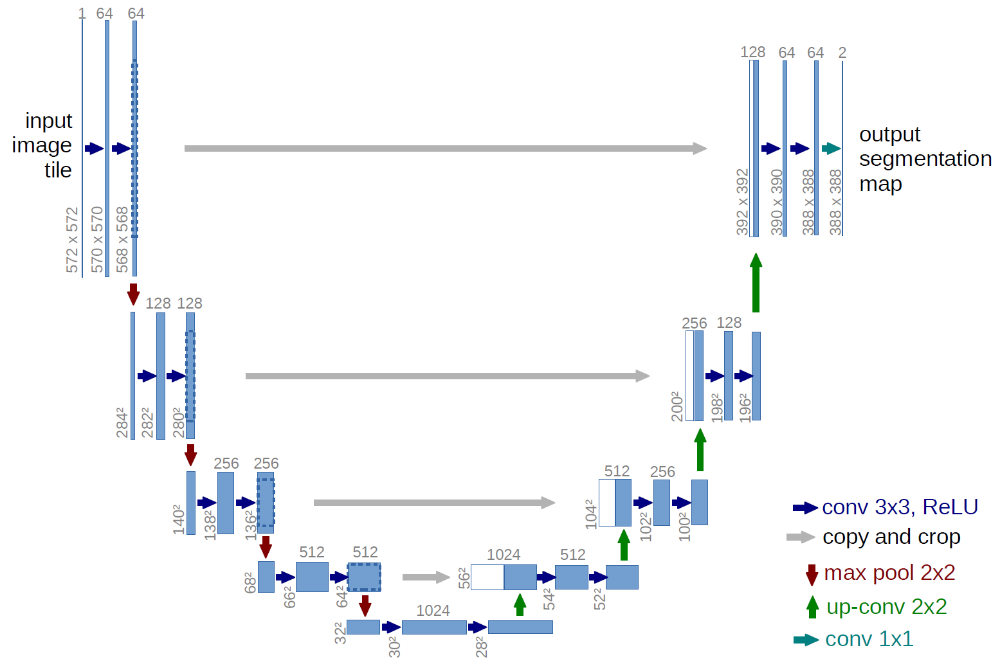

*U-net architecture (example for 32x32 pixels in the lowest resolution). Each blue box corresponds to a multi-channel feature map. The number of channels is denoted on top of the box. The x-y-size is provided at the lower left edge of the box. White boxes represent copied feature maps. The arrows denote the different operations.*

## Training and Validating

###Evaluation method

For text-to-image models, “accuracy” isn’t as straightforward as in classification tasks, because there’s no single correct output — an image can match a prompt in many valid ways. Instead, researchers use a mix of automatic metrics and human evaluation to measure how well the generated images match the text and look good.

In our previous project, when fine-tuning Stable Diffusion, we used CLIPScore as our evaluation metric. However, after several trials, we found that CLIPScore was not suitable for evaluating artistic images. Consequently, we used training loss as our evaluation metric. We have chosen to continue using loss as the evaluation metric in this project.


###Evaluation funtion

This function evaluates our trained LoRA model by measuring how well it can predict noise in the diffusion process, which we will later run on validation set and test set.

What It Does:

1. Evaluation Setup:

- Sets model to eval() mode (disables dropout/training behavior)
- Uses torch.no_grad() for memory efficiency during evaluation

2. Diffusion Process Simulation:

- Encode images: movq.encode() converts images to latent space
- Add noise: Simulates the forward diffusion process
- Predict noise: Your trained UNet tries to predict the added noise
- Calculate loss: MSE between predicted and actual noise

3. Key Components:

- latents * 0.18215 → Kandinsky's scaling factor
- noise_pred[:, :4, :, :] → Takes only first 4 channels (matches noise dimensions)
- added_cond_kwargs={"image_embeds": image_embeds} → Kandinsky's conditioning format

4. Loss Calculation:

- Averages MSE loss across all batches
- Skips NaN losses (safety check)
- Returns mean loss for the entire dataset

**Purpose:**

This gives us an objective metric of how well our Unet with  LoRA learned to:

- Denoise images in the specific art style we trained on
- Use caption-derived embeddings for conditioning
- enerate coherent latent representations

Lower loss = better trained model that can more accurately reverse the noise process, leading to higher quality generated images that match your training data style.

We will explain more detail the Diffusion process in Training Loop section

In [ ]:
def evaluate_model(model, data_loader):
    model.eval()
    total_loss = 0


    with torch.no_grad():
        for batch in data_loader:
            pixel_values = batch["pixel_values"].to("cuda", dtype=torch.float32)
            image_embeds = batch["image_embeds"].to("cuda", dtype=torch.float32)

            latents = pipe.movq.encode(pixel_values).latents* 0.18215
            noise = torch.randn_like(latents)
            timesteps = torch.randint(0, pipe.scheduler.config.num_train_timesteps, (latents.shape[0],), device="cuda")
            noisy_latents = pipe.scheduler.add_noise(latents, noise, timesteps)

            noise_pred = model(noisy_latents, timesteps, encoder_hidden_states=None,
                             added_cond_kwargs={"image_embeds": image_embeds}).sample[:, :4, :, :]

            loss = F.mse_loss(noise_pred, noise)
            if not torch.isnan(loss):
                total_loss += loss.item()


    return total_loss / len(data_loader)

###Training loop

Below is a diffusion model fine-tuning loop that trains UNet to denoise images in a specific artistic style using LoRA adaptation.

Training Process:

Setup Phase:

- epochs with model checkpointing based on validation loss
- AdamW optimizer with learning rate
- Tracks training/validation losses for monitoring

Core Training Loop:

- Data Loading: Gets image pixels and their corresponding text-derived embeddings
- Encoding: Converts images to latent space using MOVQ encoder (×0.18215 scaling)
- Noise Addition: Simulates forward diffusion by adding random noise at random timesteps
- Denoising Prediction: UNet predicts what noise was added, conditioned on image embeddings
- Loss Calculation: MSE between predicted and actual noise
- Backpropagation: Updates LoRA parameters to improve noise prediction

Key Kandinsky-Specific Elements:

- pipe.movq.encode() - Uses Kandinsky's MOVQ encoder instead of VAE
- added_cond_kwargs={"image_embeds": image_embeds} - Kandinsky's conditioning format
- [:, :4, :, :] - Takes first 4 channels to match noise dimensions. In Kandinsky UNet Architecture, some diffusion models predict additional information beyond just noise, that is why we have the output noise_pred's shape ([2, 8, 32, 32]). The first 4 channels are typically the noise prediction, the next 4 might be variance or other auxiliary predictions.
For fine-tuning, we typically only need to train on the noise prediction part

Validation & Checkpointing:

Evaluates on held-out data each epoch
Saves best model based on validation performance
Prevents overfitting through early stopping mechanism

In [ ]:
# Set up number of epoch
EPOCHS = 8

# Tracking variables and model checkpointing
best_val_loss = float("inf")
save_path = os.path.join(image_dir, "best_lora_unet")
train_losses = []
val_losses = []

# Set model to training mode
unet.train()

# Initialize optimizer for LoRA parameters
optimizer = torch.optim.AdamW(unet.parameters(), lr=5e-6, weight_decay=0.01, eps=1e-6)

for epoch in range(EPOCHS):
    print(f"\nEpoch {epoch + 1}/{EPOCHS}")

    epoch_train_loss = 0

    # Training loop
    for batch_idx, batch in enumerate(tqdm(train_loader, desc="Training")):
      try:

        # Clear gradients
        optimizer.zero_grad()

        # Load batch data to GPU
        pixel_values = batch["pixel_values"].to("cuda", dtype=torch.float32)
        image_embeds = batch["image_embeds"].to("cuda", dtype=torch.float32)

        # Encode images to latent space
        with torch.no_grad():
            latents = pipe.movq.encode(pixel_values).latents* 0.18215

        # Standard diffusion training: add noise to latents
        noise = torch.randn_like(latents)
        timesteps = torch.randint(0, pipe.scheduler.config.num_train_timesteps, (latents.shape[0],), device="cuda")
        noisy_latents = pipe.scheduler.add_noise(latents, noise, timesteps)

        # UNet predicts noise conditioned on image embeddings
        noise_pred = unet(noisy_latents, timesteps, encoder_hidden_states=None,
                         added_cond_kwargs={"image_embeds": image_embeds}).sample[:, :4, :, :]
        # Compute denoising loss
        loss = F.mse_loss(noise_pred, noise)

        # Backpropagation
        loss.backward()

        # Update LoRA weights
        optimizer.step()

        # accumulate loss after each training batch
        epoch_train_loss += loss.item()

        # Log at regular percentage intervals of our dataset
        log_interval = max(1, len(train_loader) // 10)  # Log 10 times per epoch
        if batch_idx % log_interval == 0:
            print(f"Step {batch_idx}/{len(train_loader)}, Loss: {loss.item():.4f}")

      # Skip problematic batches
      except Exception as e:
        print(f"Error in batch {batch_idx}: {e}")
        continue

    # Store the average training loss for the epoch
    avg_train_loss = epoch_train_loss / len(train_loader)
    # Add the average loss for the epoch to Tracking loss
    train_losses.append(avg_train_loss)
    print(f"Epoch {epoch + 1} completed. Avg training loss: {avg_train_loss:.4f}")

    # Validation evaluation by calling evaluation_model on validation set
    print("Running validation loss evaluation...")
    val_epoch_loss = evaluate_model(unet, val_loader)
    val_losses.append(val_epoch_loss)
    print(f"Validation loss: {val_epoch_loss:.4f}")

    # Save best model checkpoint
    if val_epoch_loss < best_val_loss:
        best_val_loss = val_epoch_loss
        unet.save_pretrained(save_path)
        print(f"New best model saved! Val Loss: {best_val_loss:.6f}")

    # Reset to training mode after validation
    unet.train()

print(f"Best Validation Loss: {best_val_loss:.4f}")





Epoch 1/8


Training:   0%|          | 1/1200 [00:00<16:40,  1.20it/s]

Step 0/1200, Loss: 0.2716


Training:  10%|█         | 121/1200 [00:26<03:47,  4.74it/s]

Step 120/1200, Loss: 0.0445


Training:  20%|██        | 241/1200 [00:51<03:18,  4.83it/s]

Step 240/1200, Loss: 0.1517


Training:  30%|███       | 362/1200 [01:16<02:50,  4.92it/s]

Step 360/1200, Loss: 0.0218


Training:  40%|████      | 481/1200 [01:41<02:30,  4.79it/s]

Step 480/1200, Loss: 0.0032


Training:  50%|█████     | 601/1200 [02:06<02:04,  4.82it/s]

Step 600/1200, Loss: 0.0147


Training:  60%|██████    | 721/1200 [02:31<01:41,  4.73it/s]

Step 720/1200, Loss: 0.0237


Training:  70%|███████   | 841/1200 [02:56<01:14,  4.84it/s]

Step 840/1200, Loss: 0.0134


Training:  80%|████████  | 961/1200 [03:21<00:48,  4.91it/s]

Step 960/1200, Loss: 0.0053


Training:  90%|█████████ | 1081/1200 [03:45<00:23,  5.06it/s]

Step 1080/1200, Loss: 0.0092


Training: 100%|██████████| 1200/1200 [04:09<00:00,  4.80it/s]


Epoch 1 completed. Avg training loss: 0.0354
Running validation loss evaluation...
Validation loss: 0.0321
New best model saved! Val Loss: 0.032063

Epoch 2/8


Training:   0%|          | 1/1200 [00:00<04:24,  4.53it/s]

Step 0/1200, Loss: 0.0077


Training:  10%|█         | 122/1200 [00:24<03:34,  5.03it/s]

Step 120/1200, Loss: 0.0461


Training:  20%|██        | 242/1200 [00:49<03:12,  4.99it/s]

Step 240/1200, Loss: 0.0570


Training:  30%|███       | 361/1200 [01:13<02:51,  4.88it/s]

Step 360/1200, Loss: 0.0775


Training:  40%|████      | 481/1200 [01:37<02:28,  4.84it/s]

Step 480/1200, Loss: 0.0401


Training:  50%|█████     | 602/1200 [02:02<02:04,  4.79it/s]

Step 600/1200, Loss: 0.0361


Training:  60%|██████    | 722/1200 [02:27<01:37,  4.89it/s]

Step 720/1200, Loss: 0.0138


Training:  70%|███████   | 841/1200 [02:51<01:14,  4.81it/s]

Step 840/1200, Loss: 0.0094


Training:  80%|████████  | 961/1200 [03:16<00:48,  4.93it/s]

Step 960/1200, Loss: 0.0013


Training:  90%|█████████ | 1081/1200 [03:40<00:24,  4.87it/s]

Step 1080/1200, Loss: 0.0084


Training: 100%|██████████| 1200/1200 [04:04<00:00,  4.90it/s]


Epoch 2 completed. Avg training loss: 0.0290
Running validation loss evaluation...
Validation loss: 0.0264
New best model saved! Val Loss: 0.026376

Epoch 3/8


Training:   0%|          | 2/1200 [00:00<03:59,  5.01it/s]

Step 0/1200, Loss: 0.0049


Training:  10%|█         | 122/1200 [00:24<03:33,  5.05it/s]

Step 120/1200, Loss: 0.0176


Training:  20%|██        | 242/1200 [00:49<03:13,  4.96it/s]

Step 240/1200, Loss: 0.0019


Training:  30%|███       | 361/1200 [01:13<02:52,  4.86it/s]

Step 360/1200, Loss: 0.0003


Training:  40%|████      | 481/1200 [01:38<02:26,  4.92it/s]

Step 480/1200, Loss: 0.0478


Training:  50%|█████     | 601/1200 [02:02<02:04,  4.83it/s]

Step 600/1200, Loss: 0.0052


Training:  60%|██████    | 722/1200 [02:27<01:35,  4.98it/s]

Step 720/1200, Loss: 0.0258


Training:  70%|███████   | 842/1200 [02:51<01:11,  5.03it/s]

Step 840/1200, Loss: 0.0021


Training:  80%|████████  | 962/1200 [03:16<00:47,  5.02it/s]

Step 960/1200, Loss: 0.0389


Training:  90%|█████████ | 1081/1200 [03:40<00:23,  5.08it/s]

Step 1080/1200, Loss: 0.0061


Training: 100%|██████████| 1200/1200 [04:04<00:00,  4.90it/s]


Epoch 3 completed. Avg training loss: 0.0240
Running validation loss evaluation...
Validation loss: 0.0175
New best model saved! Val Loss: 0.017511

Epoch 4/8


Training:   0%|          | 2/1200 [00:00<04:00,  4.98it/s]

Step 0/1200, Loss: 0.0046


Training:  10%|█         | 121/1200 [00:24<03:42,  4.86it/s]

Step 120/1200, Loss: 0.0060


Training:  20%|██        | 241/1200 [00:49<03:22,  4.73it/s]

Step 240/1200, Loss: 0.0013


Training:  30%|███       | 361/1200 [01:13<02:46,  5.03it/s]

Step 360/1200, Loss: 0.0063


Training:  40%|████      | 482/1200 [01:38<02:26,  4.90it/s]

Step 480/1200, Loss: 0.0557


Training:  50%|█████     | 601/1200 [02:02<02:03,  4.84it/s]

Step 600/1200, Loss: 0.3005


Training:  60%|██████    | 722/1200 [02:27<01:39,  4.82it/s]

Step 720/1200, Loss: 0.0028


Training:  70%|███████   | 842/1200 [02:52<01:12,  4.93it/s]

Step 840/1200, Loss: 0.0055


Training:  80%|████████  | 962/1200 [03:16<00:48,  4.94it/s]

Step 960/1200, Loss: 0.0016


Training:  90%|█████████ | 1082/1200 [03:41<00:23,  5.05it/s]

Step 1080/1200, Loss: 0.0367


Training: 100%|██████████| 1200/1200 [04:05<00:00,  4.90it/s]


Epoch 4 completed. Avg training loss: 0.0182
Running validation loss evaluation...
Validation loss: 0.0176

Epoch 5/8


Training:   0%|          | 1/1200 [00:00<03:56,  5.06it/s]

Step 0/1200, Loss: 0.0018


Training:  10%|█         | 122/1200 [00:25<03:41,  4.87it/s]

Step 120/1200, Loss: 0.0040


Training:  20%|██        | 241/1200 [00:49<03:17,  4.86it/s]

Step 240/1200, Loss: 0.0019


Training:  30%|███       | 362/1200 [01:14<02:50,  4.91it/s]

Step 360/1200, Loss: 0.0168


Training:  40%|████      | 481/1200 [01:38<02:28,  4.85it/s]

Step 480/1200, Loss: 0.0069


Training:  50%|█████     | 602/1200 [02:03<02:00,  4.94it/s]

Step 600/1200, Loss: 0.0201


Training:  60%|██████    | 721/1200 [02:27<01:40,  4.76it/s]

Step 720/1200, Loss: 0.0044


Training:  70%|███████   | 841/1200 [02:52<01:13,  4.86it/s]

Step 840/1200, Loss: 0.0003


Training:  80%|████████  | 962/1200 [03:16<00:47,  5.03it/s]

Step 960/1200, Loss: 0.0002


Training:  90%|█████████ | 1082/1200 [03:41<00:23,  5.04it/s]

Step 1080/1200, Loss: 0.2296


Training: 100%|██████████| 1200/1200 [04:05<00:00,  4.89it/s]


Epoch 5 completed. Avg training loss: 0.0169
Running validation loss evaluation...
Validation loss: 0.0189

Epoch 6/8


Training:   0%|          | 1/1200 [00:00<04:24,  4.54it/s]

Step 0/1200, Loss: 0.0009


Training:  10%|█         | 121/1200 [00:24<03:37,  4.95it/s]

Step 120/1200, Loss: 0.0011


Training:  20%|██        | 241/1200 [00:48<03:14,  4.93it/s]

Step 240/1200, Loss: 0.0201


Training:  30%|███       | 362/1200 [01:13<02:52,  4.87it/s]

Step 360/1200, Loss: 0.0084


Training:  40%|████      | 481/1200 [01:37<02:31,  4.74it/s]

Step 480/1200, Loss: 0.0188


Training:  50%|█████     | 601/1200 [02:01<02:00,  4.95it/s]

Step 600/1200, Loss: 0.0024


Training:  60%|██████    | 722/1200 [02:26<01:36,  4.97it/s]

Step 720/1200, Loss: 0.0023


Training:  70%|███████   | 842/1200 [02:50<01:11,  4.99it/s]

Step 840/1200, Loss: 0.0006


Training:  80%|████████  | 961/1200 [03:14<00:49,  4.79it/s]

Step 960/1200, Loss: 0.0005


Training:  90%|█████████ | 1082/1200 [03:39<00:24,  4.89it/s]

Step 1080/1200, Loss: 0.0019


Training: 100%|██████████| 1200/1200 [04:03<00:00,  4.93it/s]


Epoch 6 completed. Avg training loss: 0.0174
Running validation loss evaluation...
Validation loss: 0.0109
New best model saved! Val Loss: 0.010910

Epoch 7/8


Training:   0%|          | 1/1200 [00:00<04:11,  4.76it/s]

Step 0/1200, Loss: 0.0008


Training:  10%|█         | 121/1200 [00:24<03:36,  4.98it/s]

Step 120/1200, Loss: 0.0045


Training:  20%|██        | 241/1200 [00:49<03:13,  4.95it/s]

Step 240/1200, Loss: 0.1162


Training:  30%|███       | 361/1200 [01:13<02:51,  4.90it/s]

Step 360/1200, Loss: 0.0133


Training:  40%|████      | 481/1200 [01:38<02:29,  4.81it/s]

Step 480/1200, Loss: 0.0011


Training:  50%|█████     | 602/1200 [02:03<02:01,  4.93it/s]

Step 600/1200, Loss: 0.0077


Training:  60%|██████    | 721/1200 [02:27<01:39,  4.84it/s]

Step 720/1200, Loss: 0.0007


Training:  70%|███████   | 842/1200 [02:51<01:11,  5.00it/s]

Step 840/1200, Loss: 0.0033


Training:  80%|████████  | 962/1200 [03:16<00:48,  4.91it/s]

Step 960/1200, Loss: 0.0283


Training:  90%|█████████ | 1082/1200 [03:40<00:23,  4.94it/s]

Step 1080/1200, Loss: 0.0002


Training: 100%|██████████| 1200/1200 [04:04<00:00,  4.90it/s]


Epoch 7 completed. Avg training loss: 0.0136
Running validation loss evaluation...
Validation loss: 0.0204

Epoch 8/8


Training:   0%|          | 2/1200 [00:00<03:58,  5.01it/s]

Step 0/1200, Loss: 0.0003


Training:  10%|█         | 122/1200 [00:24<03:46,  4.77it/s]

Step 120/1200, Loss: 0.0002


Training:  20%|██        | 241/1200 [00:48<03:13,  4.95it/s]

Step 240/1200, Loss: 0.0104


Training:  30%|███       | 362/1200 [01:13<02:51,  4.88it/s]

Step 360/1200, Loss: 0.0003


Training:  40%|████      | 481/1200 [01:37<02:26,  4.91it/s]

Step 480/1200, Loss: 0.0001


Training:  50%|█████     | 602/1200 [02:01<02:01,  4.91it/s]

Step 600/1200, Loss: 0.0100


Training:  60%|██████    | 722/1200 [02:26<01:35,  4.99it/s]

Step 720/1200, Loss: 0.0035


Training:  70%|███████   | 841/1200 [02:50<01:14,  4.80it/s]

Step 840/1200, Loss: 0.0034


Training:  80%|████████  | 961/1200 [03:14<00:49,  4.81it/s]

Step 960/1200, Loss: 0.0006


Training:  90%|█████████ | 1081/1200 [03:39<00:24,  4.90it/s]

Step 1080/1200, Loss: 0.0007


Training: 100%|██████████| 1200/1200 [04:04<00:00,  4.91it/s]


Epoch 8 completed. Avg training loss: 0.0169
Running validation loss evaluation...
Validation loss: 0.0082
New best model saved! Val Loss: 0.008245
Best Validation Loss: 0.0082


##Testing

In [ ]:


print("Evaluating on test set...")

# Load best model: Retrieves the LoRA weights that achieved lowest validation loss
pipe.unet = PeftModel.from_pretrained(pipe.unet, save_path)

# Evaluate on test set using loss
test_loss = evaluate_model(pipe.unet, test_loader)
print(f"Test Loss: {test_loss:.4f}")

Evaluating on test set...


/usr/local/lib/python3.12/dist-packages/peft/tuners/tuners_utils.py:196: UserWarning: Already found a `peft_config` attribute in the model. This will lead to having multiple adapters in the model. Make sure to know what you are doing!
  warnings.warn(


Test Loss: 0.0111


## Plotting and Evaluation on the training/validation and test result

Training Losses: [0.035418711641626334, 0.029001465941194814, 0.02402724560881931, 0.018217356997259532, 0.016896204614028344, 0.01738297637029973, 0.013592098024661632, 0.01692769451773832]
Validation Losses: [0.03206310462405478, 0.026375929848776045, 0.01751131823975205, 0.01763966045487905, 0.01887338465884871, 0.010909987477061804, 0.020408901459401628, 0.00824524433449066]
Final Test Loss: 0.011134155790738684




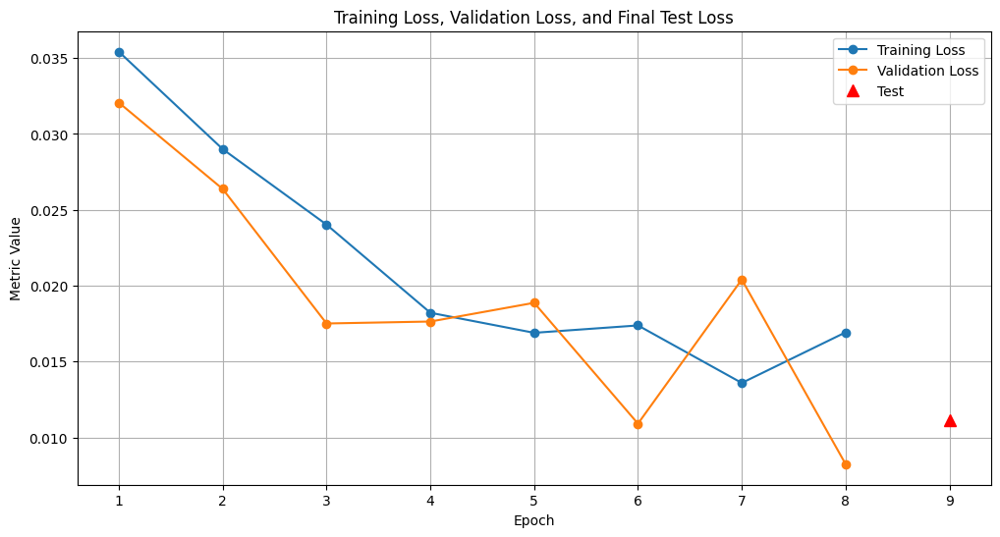


Training Loss, Validation Loss, and Final Test Loss plots.


In [ ]:


train_losses, val_losses, test_loss

print(f"Training Losses: {train_losses}")
print(f"Validation Losses: {val_losses}")
print(f"Final Test Loss: {test_loss}")
print("\n")

# Plot the training losses, validation losses, and average CLIP scores
plt.figure(figsize=(12, 6))

# Plot Training Loss
plt.plot(range(1, len(train_losses) + 1), train_losses, marker='o', linestyle='-', label='Training Loss')

# Plot Validation Loss
plt.plot(range(1, len(val_losses) + 1), val_losses, marker='o', linestyle='-', label='Validation Loss')

# Plot Final Test Loss
if test_loss is not None:
    plt.plot([len(val_losses) + 1], [test_loss], 'r^', markersize=8, label='Test')


plt.title('Training Loss, Validation Loss, and Final Test Loss')
plt.xlabel('Epoch')
plt.ylabel('Metric Value')
plt.grid(True)
plt.legend()
plt.show()

print("\nTraining Loss, Validation Loss, and Final Test Loss plots.")

Fine-tuning results on 3000 Impressionism dataset using Kandinsky 2.2 UNet with LoRA configuration: r=8, alpha=8, learning rate 5e-6, dropout=0.1 over 8 epochs:

Loss Progression:

- Training: 0.035 → 0.014 (60% reduction over 8 epochs)
- Validation: 0.032 → 0.008 (75% reduction)
- Test: 0.011 (strong generalization)

Training Pattern:

- Strong initial learning (epochs 1-4): Loss drops from 0.035 to 0.018
- Plateau phase (epochs 5-8): Oscillates around 0.014-0.017
- This suggests the model reached its learning capacity with current configuration

Validation Behavior:

- Validation loss is more volatile than training loss
- Final validation (0.008) is significantly lower than training (0.017)
- This unusual pattern suggests either: small validation set, or the model generalizes better to certain types of samples

Optimization Quality:

- No signs of overfitting despite 8 epochs
- Learning rate appears well-calibrated - no instability or stagnation
- LoRA rank of 8 provides sufficient capacity without overfitting

##Another Plotting on different parameters

**Training Losses:** [0.033078522458449694, 0.0316185768285959, 0.027863860874122112, 0.019327572847778356, 0.01858264457039695, 0.017410246139597803]

**Validation Losses:** [0.04094128308526706, 0.03549232643308642, 0.0253943160756171, 0.020797455486026593, 0.01758698671095772, 0.021829626334365457]

**Final Test Loss:** 0.016497830978478303



Train with 2000 number of dataset on Action painint art style.
LoRA configuration: r=4, alpha=8, learning rate 5e-6, dropout=0.1 over 6 epochs.


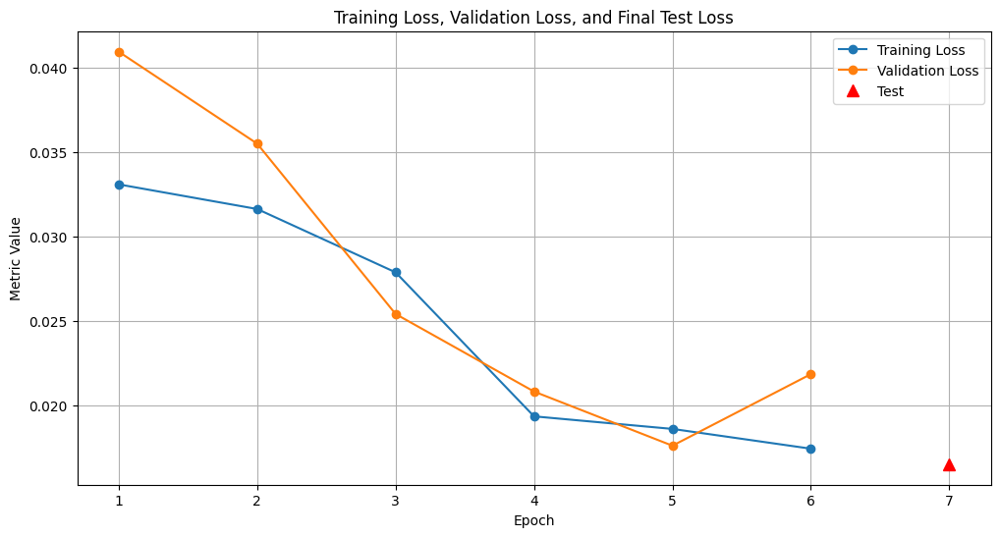

**Overview**

- Training Losses:
Shows a clear decreasing trend, indicating effective learning of the U-Net for denoising and capturing the style.

- Validation Losses:
Mostly decreasing, with a slight uptick in the last epoch, suggesting minor fluctuations but overall good generalization.

- Final Test Loss: 0.0165

Confirms the model performs well on unseen data, closely matching the best validation performance.

**Interpretation**

- Even with a relatively small dataset (2000 images), the model successfully learned the Action Painting style.

- The LoRA setup (r=4, alpha=8) with a low learning rate stabilized training and allowed efficient fine-tuning without overfitting.

- Slight fluctuations in validation loss are normal, especially with smaller datasets.

##Conclusion

- Using LoRA enabled efficient fine-tuning with lower GPU memory usage while still capturing complex artistic features.

- Higher rank (r=8) and adequate dropout helped improve learning on larger datasets, while lower rank (r=4) worked well on smaller datasets.

- The results confirm that Kandinsky 2.2 U-Net can be effectively adapted to specific art styles, producing visually accurate and stylistically coherent images.

# Testing on human evaluation

Switching the UNet to evaluation mode.

In [ ]:
  pipe.unet.eval()

PeftModel(
  (base_model): LoraModel(
    (model): UNet2DConditionModel(
      (conv_in): Conv2d(4, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (time_proj): Timesteps()
      (time_embedding): TimestepEmbedding(
        (linear_1): Linear(in_features=384, out_features=1536, bias=True)
        (act): SiLU()
        (linear_2): Linear(in_features=1536, out_features=1536, bias=True)
      )
      (encoder_hid_proj): ImageProjection(
        (image_embeds): Linear(in_features=1280, out_features=24576, bias=True)
        (norm): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
      )
      (add_embedding): ImageTimeEmbedding(
        (image_proj): Linear(in_features=1280, out_features=1536, bias=True)
        (image_norm): LayerNorm((1536,), eps=1e-05, elementwise_affine=True)
      )
      (down_blocks): ModuleList(
        (0): ResnetDownsampleBlock2D(
          (resnets): ModuleList(
            (0-2): 3 x ResnetBlock2D(
              (norm1): GroupNorm(32, 384, e

##Prompt

In [ ]:
# Create a Textarea widget
text_area = Textarea(
    value='',
    placeholder='Enter your describe your art here',
    description='Text:',
    disabled=False,
    layout={'width': '900px'}
)



# Create an output widget to display results
output_widget = Output()

# Create Label widgets for the text prompts
prompt_label = Label('Describe your art')


# Arrange the widgets vertically
form = VBox([prompt_label, text_area, output_widget])

# Display the form
display(form)

Prompt with artstyle we used to finetune model

In [ ]:
prompt = f"{text_area.value} in {style} art style "
print(prompt)

a girl praying near a church  in Impressionism art style 


##Generated image using LoRA-finetuned U-Net model

In [ ]:
negative_prompt = " " # optional to include a negative prompt, but results are usually better

with torch.no_grad():
  image_embeds, negative_image_embeds = prior(prompt, guidance_scale=1.0).to_tuple()
  image = pipe(image_embeds=image_embeds, negative_image_embeds=negative_image_embeds, height=768, width=768).images[0]


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

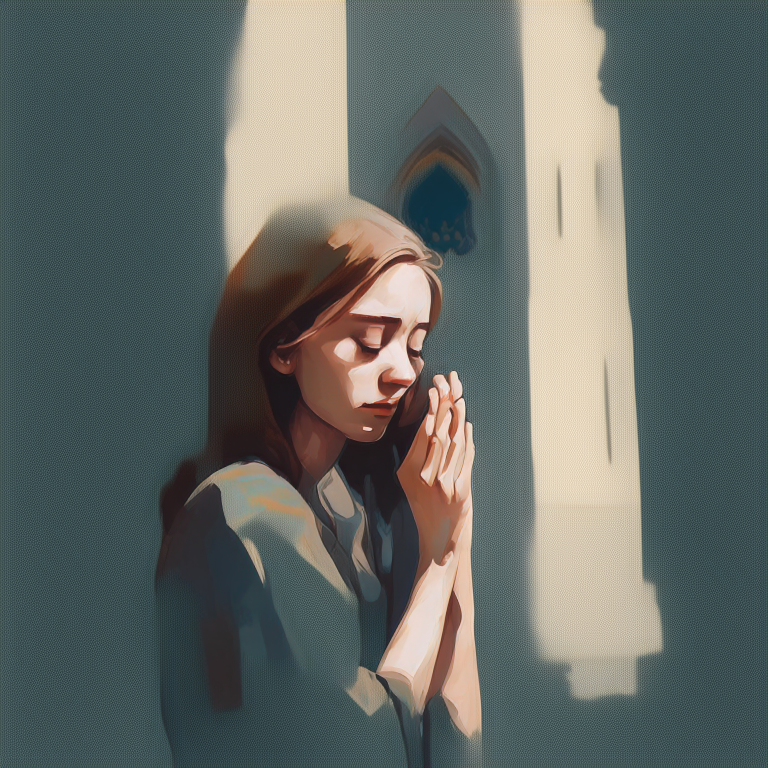

In [ ]:
image

The art style appears more animated/cartoony rather than the Impressionism style that we used for training. Although the training results (training and validation loss decreasing) showed that the model was learning, after several tests comparing the fine-tuned model with the original pretrained model, we observed that the decoder did not capture our target art style. In the end, we concluded that it is necessary to train the prior component as well.

##Generated image with pretrained model before fine tune

In [ ]:


prior_pipeline = KandinskyV22PriorPipeline.from_pretrained("kandinsky-community/kandinsky-2-2-prior", torch_dtype=torch.float16).to("cuda")
pipeline = KandinskyV22Pipeline.from_pretrained("kandinsky-community/kandinsky-2-2-decoder", torch_dtype=torch.float16).to("cuda")


negative_prompt = " " # optional to include a negative prompt, but results are usually better
image_embeds_, negative_image_embeds_ = prior_pipeline(prompt, guidance_scale=1.0).to_tuple()
image2 = pipeline(image_embeds=image_embeds, negative_image_embeds=negative_image_embeds, height=768, width=768).images[0]


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

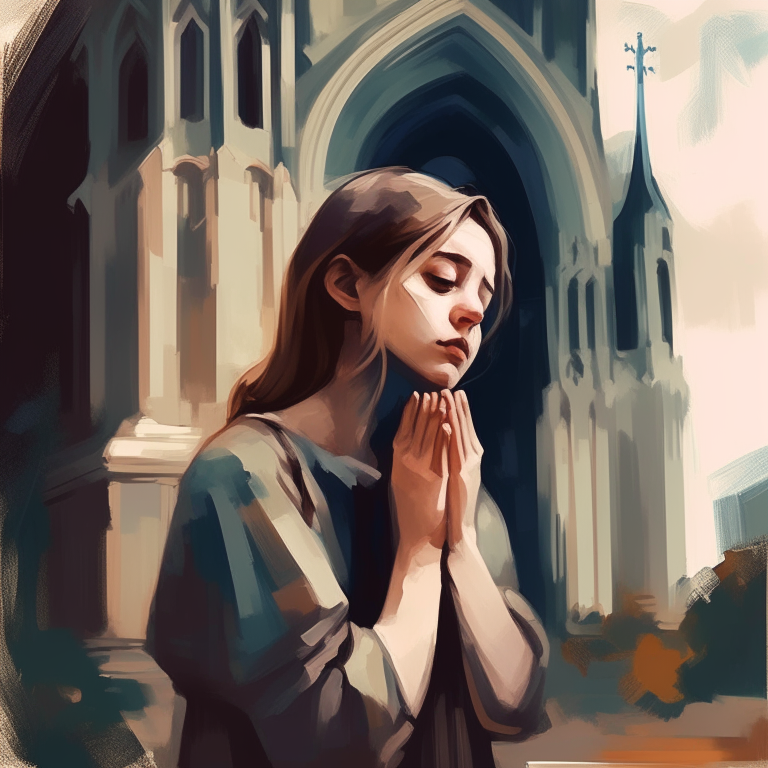

In [ ]:

image2

We generated an image using the same prompt from the pre-finetuned model to see how it would look. This image and the one generated by our fine-tuned model look similar in style. This indicates that our fine-tuned model has not yet learned the art style we used for training.

## Image generted using image embedding of dataset

We are investigating why our model has not yet learned the target style. One of our methods is to take the image embedding of an image from our dataset—an image the model has already seen—and generate an image from the fine-tuned model to see how it would look.

In [ ]:
test_embed = dataset.image_embeds[0].to("cuda")  # Use a precomputed embed
with torch.no_grad():
  negative_image_embeds = prior(prompt, guidance_scale=1.0).negative_image_embeds
  image3 = pipe(image_embeds=test_embed.unsqueeze(0), negative_image_embeds=negative_image_embeds, height=768, width=768).images[0]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

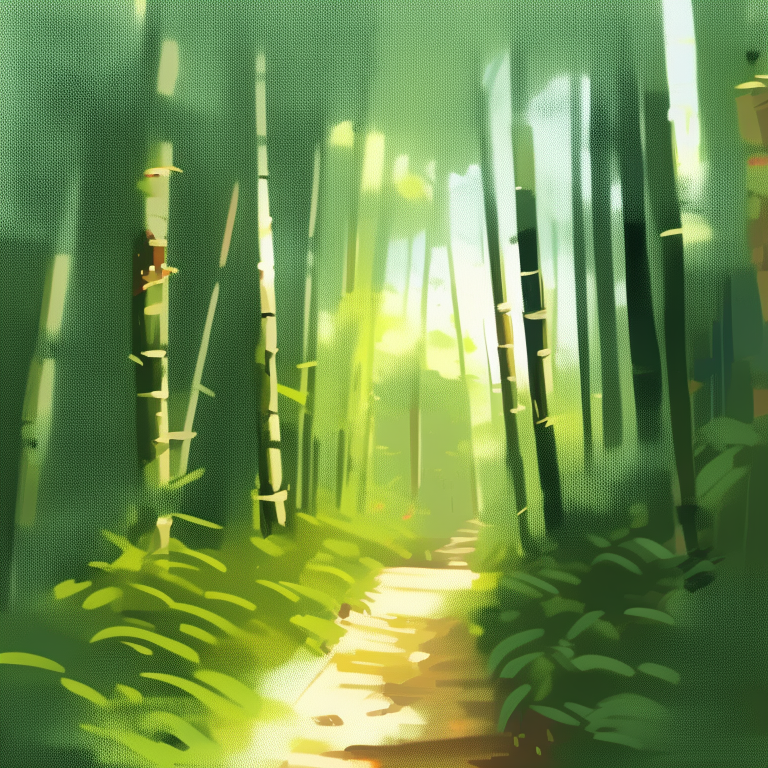

In [ ]:
image3

The image’s style is the same as that of the model before fine-tuning. Now, we will examine how the image—whose embeddings we used for testing—looks within our dataset.

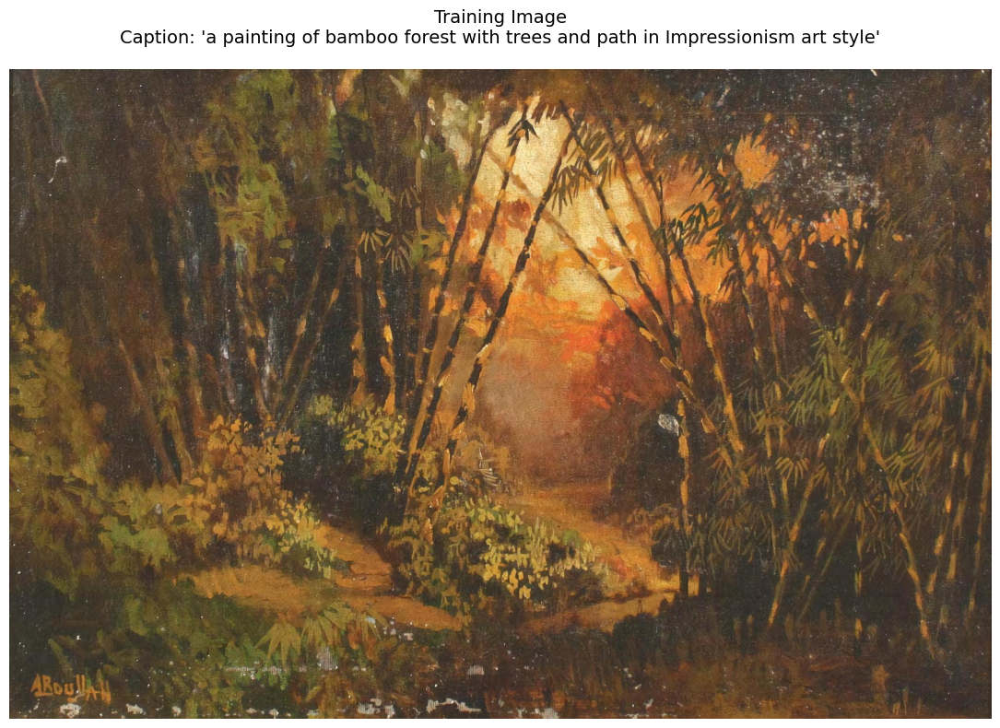

In [ ]:
# Load image and caption
img_path = "/content/project/selected_genre/Impressionism/abdullah-suriosubroto_indonesian-landscape-3.jpg"
caption_path = "/content/project/selected_genre/captions/abdullah-suriosubroto_indonesian-landscape-3.txt"

img = Image.open(img_path)
with open(caption_path, "r", encoding="utf-8") as f:
    caption = f.read().strip()

# Display together
plt.figure(figsize=(12, 8))
plt.imshow(img)
plt.axis('off')
plt.title(f"Training Image\nCaption: '{caption}'", fontsize=14, pad=20)
plt.tight_layout()
plt.show()

This is the actual image we used for training, with the caption: "A painting of a bamboo forest with trees and a path in Impressionism art style." Even though our fine-tuned model generated an image that followed the caption, the style is still very different from the one in the training image.

In [ ]:
!nvidia-smi

Wed Aug 20 06:36:28 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA A100-SXM4-40GB          Off |   00000000:00:04.0 Off |                    0 |
| N/A   33C    P0             49W /  400W |   40181MiB /  40960MiB |      0%      Default |
|                                         |                        |             Disabled |
+-----------------------------------------+-----

After further investigation, we realized that we need to train the other component, the Prior, in order for our model to generate images in the trained art style. However, due to time and GPU limitations, we are unable to do this here. We plan to perform the Prior training separately, save the results, and test it later.

##Conclusion

Based on the training result and image generated from the fine tune model. We can see that training on Unet part alone for Kandinsky architecture is not enough, because:

1. **Text-Image Alignment Problem**

**The Prior handles semantic mapping**: The Image Prior is responsible for translating text concepts into the visual embedding space that the U-Net can understand. Without training the prior:

- Poor text understanding: The U-Net receives poorly aligned image embeddings that don't match your specific text concepts
- Semantic gaps: Your custom concepts may not exist in the original CLIP embedding space
- Weak conditioning: The image embeddings fed to U-Net won't properly guide the generation process

2. **Two-Stage Dependency**

**Prior feeds the U-Net**: The U-Net depends entirely on the Image Prior's output as one of its main conditioning signals. If the Prior can't map our text to appropriate image embeddings, the U-Net can't generate what we want, regardless of how well it's trained.

3. **Domain-Specific Concepts**

**New concepts need embedding space mapping**: When fine-tuning for specific styles, characters, or concepts:

- The Prior needs to learn how these map to visual embeddings
- The U-Net needs to learn how to render these visual concepts
- Both stages must be aligned for coherent results

**Conclusion**

Training only the U-Net is like teaching someone to paint without teaching them to understand the description - we need both the semantic understanding (Prior) and visual execution (U-Net) to work together for effective text-to-image generation

#Challenges in this project

1. **Complicated architecture**: The components aren't from a single pipeline but from two different pipelines: the decoder and prior (unlike Stable Diffusion v1.5).
2. **Complicated Dataset Requirements**: Kandinsky's architecture requires image embeddings of captions (generated through the prior) to be combined with processed images to enter the training loop.
3. **Shape mismatch error**: We encountered errors during training because the UNet prediction output had a different shape ([2, 8, 32, 32]) compared to the added noise ([2, 4, 32, 32]) in the forward diffusion state. We later discovered that the first 4 channels of the predicted noise are typically the noise prediction, while the next 4 channels might be variance or other auxiliary predictions.
4. **Prior training requirement**: Even after the training loop could finally run and the pretrained model was fine-tuned, we realized we needed to train the prior component as well, not just the UNet component, in order for the model to generate images in the same art style as our datasets.
5. C**omplex inference process**: It's challenging to generate images from the fine-tuned model because Kandinsky requires specific parameters, including embeddings of not only the prompt but also the negative prompt.
6. **GPU limitations**: Despite using A100 GPUs in Colab, the pretrained models consume significant memory, especially Kandinsky models. This limitation prevented us from training on large datasets, restricting us to approximately 3,000 samples.

#Final conclusion

From this project we have learned:

- Kandinsky's architecture and its underlying mechanisms.

- The process of data preprocessing.

- How to fine-tune the main part of pretrained Kandinsky v2.2 model (UNet) using LoRA.

- For text-to-image models, “accuracy” isn’t as straightforward as in classification tasks, because there’s no single correct output — an image can match a prompt in many valid ways. We should a mix of automatic metrics and human evaluation to measure how well the generated images match the text and look good.
- Loss is a good indicator of training progress, but it does not fully capture artistic quality or style adherence. However, due to time limitations, we have not explored other evaluation methods in this project, aside from CLIPScore—which we previously found unsuitable in our Stable Diffusion project.
- Human evaluation remains the most reliable method for assessing art-style generation, since existing automatic metrics struggle to capture stylistic and aesthetic qualities.
- Although the training results Kandinsky 2.2 were good. The fine-tuned model did not generate images that matched the desired style. After further investigation, we concluded that for Kandinsky, it is necessary to train not only the U-Net but also the prior component. Training only the U-Net is like teaching someone to paint without teaching them how to interpret the description. Both semantic understanding (Prior) and visual execution (U-Net) must work together for effective text-to-image generation




#Preference

https://arxiv.org/abs/2310.03502

https://eugeneyan.com/writing/text-to-image/

https://theaisummer.com/diffusion-models/#cascade-diffusion-models

https://huggingface.co/kandinsky-community/kandinsky-2-2-prior

https://huggingface.co/kandinsky-community/kandinsky-2-2-decoder

https://github.com/ai-forever/diffusers/tree/main/examples/kandinsky2_2_train

